# Impact of Climate Change



Hier sind die Abflusszeitreihen in aller einzugsgebiete. 
C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\1_abfluss

der name der datei besteht aus der präfix "abfluss_" und dann der name des Einzugsgebiets (beziehungsweise der Messstelle)

Ich möchte die Abflusszeitreihen in schritte von 10 Jahre trennen 





--> Jeder Zeitabschnitt soll in feuchte und trockene Monate dazu getrennt werden: das verwenden wir später noch
Oder doch jedes jahr trennen? 
Einfach monate Trennen!!!!






für jeden Zeitabschnitt soll der DFI berechnet werden 

die entwicklung der DFIs soll analysiert werden

Frage beantworten: hat sich der Abflussmuster der Einzugsgebiete mit der Zeit verändert? 



für alle 

## Datenvorbereitung

### Datensets (10 Jahresabschnitte) erstellen

In [9]:
import pandas as pd
import os

# Verzeichnis, in dem sich die XLSX-Dateien befinden
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/1_abfluss"
output_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j"

# Liste aller Dateien im Eingabe-Verzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.endswith('.xlsx')]

# Funktion zur Erstellung von 10-Jahres-Subsets und Speichern in separaten Dateien
def create_and_save_10_year_subsets(file_path, output_verzeichnis):
    # Datei einlesen
    excel_data = pd.read_excel(file_path)
    
    # Überprüfen, ob die notwendigen Spalten vorhanden sind
    if not all(col in excel_data.columns for col in ["datum", "abfluss_norm_lskm2"]):
        print(f"Die Datei {file_path} enthält nicht die erforderlichen Spalten 'datum' und 'abfluss_norm_lskm2'.")
        return
    
    # Konvertieren der Spalte 'datum' in das Datumsformat
    excel_data['datum'] = pd.to_datetime(excel_data['datum'], format='%d.%m.%Y')
    
    # Den Messstellen-Namen aus dem Dateinamen extrahieren
    messstelle_name = os.path.basename(file_path).replace('abfluss_', '').replace('.xlsx', '')
    
    # Daten in 10-Jahres-Abschnitte aufteilen
    aktuelle_jahr = 2022
    while aktuelle_jahr >= excel_data['datum'].dt.year.min():
        start_datum = pd.Timestamp(f"{aktuelle_jahr - 9}-01-01")
        end_datum = pd.Timestamp(f"{aktuelle_jahr}-12-31")
        
        # Daten für den aktuellen 10-Jahres-Abschnitt filtern
        abschnitt_daten = excel_data[(excel_data['datum'] >= start_datum) & (excel_data['datum'] <= end_datum)]
        
        if not abschnitt_daten.empty:
            # Dateinamen für die Ausgabedatei
            output_datei_name = f"abfluss_{messstelle_name}_{aktuelle_jahr-9}_{aktuelle_jahr}.xlsx"
            
            # Pfad zur Ausgabedatei
            output_pfad = os.path.join(output_verzeichnis, output_datei_name)
            
            # Speichern des DataFrames als separate Excel-Datei
            abschnitt_daten.to_excel(output_pfad, index=False)
            
            print(f"Bearbeitete Datei für den Zeitraum {aktuelle_jahr - 9} bis {aktuelle_jahr} gespeichert unter: {output_pfad}")
        
        aktuelle_jahr -= 10

# Ergebnisse für alle Dateien speichern
for datei in alle_dateien:
    print(f"Verarbeite Datei: {datei}")
    create_and_save_10_year_subsets(datei, output_verzeichnis)

print("Die 10-Jahres-Subsets wurden erfolgreich erstellt und gespeichert.")


Verarbeite Datei: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/1_abfluss\abfluss_abentheuer.xlsx
Bearbeitete Datei für den Zeitraum 2013 bis 2022 gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j\abfluss_abentheuer_2013_2022.xlsx
Bearbeitete Datei für den Zeitraum 2003 bis 2012 gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j\abfluss_abentheuer_2003_2012.xlsx
Bearbeitete Datei für den Zeitraum 1993 bis 2002 gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j\abfluss_abentheuer_1993_2002.xlsx
Bearbeitete Datei für den Zeitraum 1983 bis 1992 gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j\abfluss_abentheuer_1983_1992.xlsx
Bearbeitete Datei für den Zeitraum 1973 bis 1982 gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Maste

### Datum formatieren!

In [10]:
import os
import pandas as pd

# Verzeichnis mit den Excel-Dateien
input_directory = r'C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\6_saisonalitaet_klimawandel\10j'

# Liste der Dateien im Eingabeverzeichnis
file_list = os.listdir(input_directory)

# Schleife über jede Excel-Datei
for file_name in file_list:
    if file_name.endswith('.xlsx'):
        # Vollständiger Pfad zur aktuellen Excel-Datei
        input_file_path = os.path.join(input_directory, file_name)
        
        # Einlesen der Excel-Datei
        df = pd.read_excel(input_file_path)
        
        # Ändern des Datumsformats
        df['datum'] = pd.to_datetime(df['datum']).dt.strftime('%d.%m.%Y')
        
        # Speichern der bearbeiteten Excel-Datei (Überschreiben der Originaldatei)
        df.to_excel(input_file_path, index=False)

print("Vorgang abgeschlossen.")


Vorgang abgeschlossen.


### DFI für alle 10j-Subsets (alle Messstellen)

In [1]:
# Laden der benötigten Pakete
library(readxl)
library(delayedflow)
library(openxlsx)

# Verzeichnis, in dem sich die XLSX-Dateien befinden
input_verzeichnis <- "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j"

# Verzeichnis, in das die bearbeiteten Dateien exportiert werden sollen
output_verzeichnis <- "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j"

# Liste aller Dateien im Eingabe-Verzeichnis
alle_dateien <- list.files(path = input_verzeichnis, pattern = "\\.xlsx$", full.names = TRUE)



# Schleife durch alle Dateien
for (datei in alle_dateien) {
  # Überprüfen, ob die Datei keine temporäre Excel-Datei ist und ob sie eine gültige Excel-Datei ist
  if (!grepl("~$", basename(datei)) & file.info(datei)$size > 0) {
    print(paste("Verarbeite Datei:", datei))  # Debug-Ausgabe
    
    # Versuche, die Datei einzulesen
    tryCatch({
      # Datei einlesen
      excel_data <- read_excel(datei)
      
      # Hier deine Datenbearbeitungsschritte mit delayedflow durchführen
      dfi_berechnung <- dfi_n(excel_data$abfluss_norm_lskm2, n = 1:360)
      
      # Den Basisnamen aus dem Dateinamen extrahieren
      basis_name <- gsub("abfluss_", "", tools::file_path_sans_ext(basename(datei)))
      
      # Dateinamen für die Ausgabedatei
      output_datei_name <- paste0("dfi_", basis_name, ".xlsx")
      
      # Pfad zur Ausgabedatei
      output_pfad <- file.path(output_verzeichnis, output_datei_name)
      
      # Speichern der bearbeiteten Spalte als separate Excel-Datei
      write.xlsx(data.frame(dfi_berechnung), output_pfad, rowNames = FALSE)
      
      print(paste("Bearbeitete Datei gespeichert unter:", output_pfad))  # Debug-Ausgabe
    }, error = function(e) {
      print(paste("Fehler beim Lesen der Datei:", datei))  # Debug-Ausgabe
      print(e)  # Debug-Ausgabe
    })
  }
}



[1] "Verarbeite Datei: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j/abfluss_abentheuer_1953_1962.xlsx"
[1] "Bearbeitete Datei gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j/dfi_abentheuer_1953_1962.xlsx"
[1] "Verarbeite Datei: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j/abfluss_abentheuer_1963_1972.xlsx"
[1] "Bearbeitete Datei gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j/dfi_abentheuer_1963_1972.xlsx"
[1] "Verarbeite Datei: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j/abfluss_abentheuer_1973_1982.xlsx"
[1] "Bearbeitete Datei gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j/dfi_abentheuer_1973_1982.xlsx"
[1] "Verarbeite Datei: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawande

Überprüfung der Daten

In [1]:
import os
import pandas as pd

# Verzeichnisse
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j"

# Liste aller Dateien im Eingabeverzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.endswith('.xlsx')]

# Dictionary, um die unvollständigen Messstellen pro Datei zu speichern
unvollstaendige_messstellen_pro_datei = {}

# Daten aus jeder Datei lesen und prüfen, welche Messstellen nicht vollständig sind
for datei in alle_dateien:
    try:
        # Datei einlesen
        df = pd.read_excel(datei)
        
        # Basisname der Datei extrahieren
        dekade = os.path.basename(datei).replace('dfi_join_', '').replace('.xlsx', '')
        
        # Liste der unvollständigen Messstellen für die aktuelle Datei
        unvollstaendige = []
        
        # Überprüfen, welche Spalten nicht alle 360 Zeilen haben
        for col in df.columns[1:]:  # Überspringe die erste Spalte "n"
            if df[col].isnull().sum() > 0 or len(df[col]) < 360:
                unvollstaendige.append(col)
        
        if unvollstaendige:
            unvollstaendige_messstellen_pro_datei[dekade] = unvollstaendige
    
    except Exception as e:
        print(f"Fehler beim Lesen der Datei {datei}: {e}")

# Liste der unvollständigen Messstellen pro Datei anzeigen
for dekade, messstellen in unvollstaendige_messstellen_pro_datei.items():
    print(f"Dekade {dekade}: {', '.join(messstellen)}")


Dekade dfi_abentheuer_1953_1962: dfi
Dekade dfi_altenbamberg_1973_1982: dfi
Dekade dfi_althornbach_1953_1962: dfi
Dekade dfi_alzey_1993_2002: dfi
Dekade dfi_betzdorf_1943_1952: dfi
Dekade dfi_bollendorf_1953_1962: dfi
Dekade dfi_boos_1943_1952: dfi
Dekade dfi_burgen_2_1963_1972: dfi
Dekade dfi_cochem_2_1973_1982: dfi
Dekade dfi_contwig_1943_1952: dfi
Dekade dfi_daun_1973_1982: dfi
Dekade dfi_densborn_2_1963_1972: dfi
Dekade dfi_dhron_talsperre_1963_1972: dfi
Dekade dfi_dreis_2_1963_1972: dfi
Dekade dfi_duppach_2_1963_1972: dfi
Dekade dfi_echtershausen_1963_1972: dfi
Dekade dfi_eichelsbacher_muehle_1963_1972: dfi
Dekade dfi_enzweiler_1973_1982: dfi
Dekade dfi_eschenau_1973_1982: dfi
Dekade dfi_fahren_1963_1972: dfi
Dekade dfi_gaugrehweiler_1973_1982: dfi
Dekade dfi_gemuend_irsen_1973_1982: dfi
Dekade dfi_gemuend_our_1963_1972: dfi
Dekade dfi_gemuend_our_1983_1992: dfi
Dekade dfi_gensingen_1953_1962: dfi
Dekade dfi_gensingen_1963_1972: dfi
Dekade dfi_gensingen_1973_1982: dfi
Dekade dfi_g

### Join Messstellen DFI je gem. Dekade! 

In [4]:
import os
import pandas as pd

# Verzeichnisse
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j"
output_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join"

# Liste aller Dateien im Eingabeverzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.endswith('.xlsx')]

# Dekaden-Bereiche
dekaden = [
    "1933_1942", "1943_1952", "1953_1962", "1963_1972",
    "1973_1982", "1983_1992", "1993_2002", "2003_2012", "2013_2022"
]

# Dictionary, um die Daten zu speichern
dekaden_daten = {dekade: pd.DataFrame() for dekade in dekaden}

# Daten aus jeder Datei lesen und nach Dekaden sortieren
for datei in alle_dateien:
    # Datei einlesen
    df = pd.read_excel(datei)
    
    # Basisname der Datei extrahieren
    basis_name = os.path.basename(datei).replace('dfi_', '').replace('.xlsx', '')
    
    # Dekadenbereich und Messstellenname aus dem Basisnamen extrahieren
    parts = basis_name.split('_')
    messstelle = parts[0]
    dekade = f"{parts[1]}_{parts[2]}"
    
    # Überprüfen, ob die Dekade im Dekaden-Bereich ist
    if dekade in dekaden_daten:
        # Spalten umbenennen, um den Messstellennamen hinzuzufügen
        df.columns = [f"{messstelle}" if col != "n" else col for col in df.columns]
        
        # Daten zum kombinierten DataFrame hinzufügen
        if dekaden_daten[dekade].empty:
            dekaden_daten[dekade] = df
        else:
            dekaden_daten[dekade] = pd.concat([dekaden_daten[dekade], df.set_index('n')], axis=1)

# Speichern der zusammengefassten Daten in separaten Excel-Dateien pro Dekade
for dekade, df in dekaden_daten.items():
    output_datei_name = f"dfi_join_{dekade}.xlsx"
    output_pfad = os.path.join(output_verzeichnis, output_datei_name)
    
    # Reset index to have 'n' as a column
    df.reset_index(inplace=True)
    
    # Speichern des DataFrames als separate Excel-Datei
    df.to_excel(output_pfad, index=False)
    
    print(f"Die zusammengefasste Datei für die Dekade {dekade} wurde erfolgreich gespeichert unter: {output_pfad}")

print("Die zusammengefassten Dateien wurden erfolgreich erstellt und gespeichert.")


Die zusammengefasste Datei für die Dekade 1933_1942 wurde erfolgreich gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join\dfi_join_1933_1942.xlsx
Die zusammengefasste Datei für die Dekade 1943_1952 wurde erfolgreich gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join\dfi_join_1943_1952.xlsx
Die zusammengefasste Datei für die Dekade 1953_1962 wurde erfolgreich gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join\dfi_join_1953_1962.xlsx
Die zusammengefasste Datei für die Dekade 1963_1972 wurde erfolgreich gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join\dfi_join_1963_1972.xlsx
Die zusammengefasste Datei für die Dekade 1973_1982 wurde erfolgreich gespeichert unter: C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join\dfi_join_1973_1982.xlsx
Die zusammengefasste Datei für die Dekade 198

## Analyse der CDCs innerhalb von Dekaden

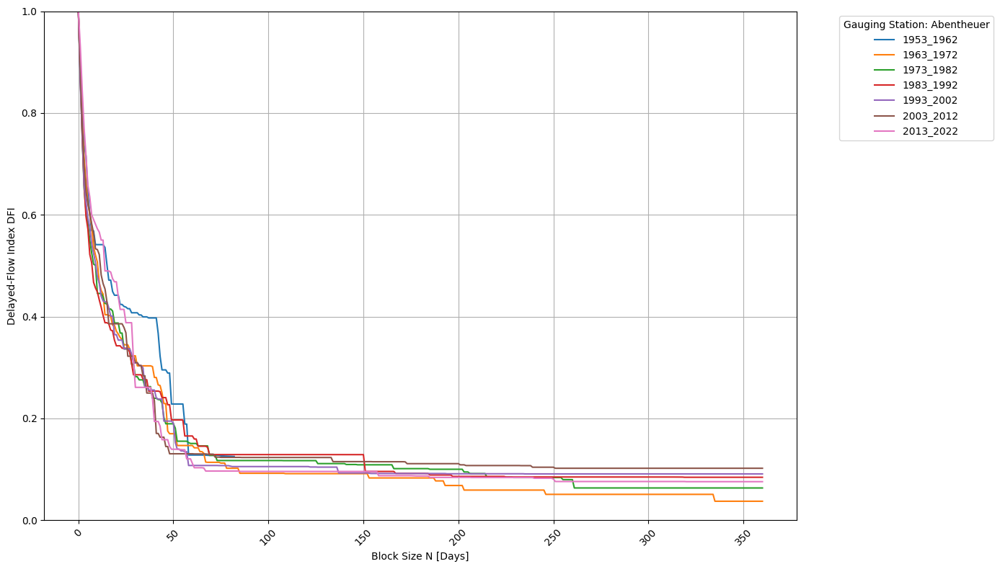

In [16]:
import os
import pandas as pd
import matplotlib.pyplot as plt

# Verzeichnis mit den Dekaden-Dateien
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join"

# Liste aller Dateien im Eingabeverzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.endswith('.xlsx')]

# DataFrame für die Messstelle Abentheuer
abentheuer_data = pd.DataFrame()

# Daten aus jeder Datei lesen und die Daten für Abentheuer sammeln
for datei in alle_dateien:
    # Datei einlesen
    dekade_df = pd.read_excel(datei)
    
    # Dekadenbereich aus dem Dateinamen extrahieren
    dekade = os.path.basename(datei).replace('dfi_join_', '').replace('.xlsx', '')
    
    # Daten für die Messstelle Abentheuer hinzufügen
    if 'abentheuer' in dekade_df.columns:
        temp_df = dekade_df[['n', 'abentheuer']].copy()
        temp_df['dekade'] = dekade
        abentheuer_data = pd.concat([abentheuer_data, temp_df], ignore_index=True)

# Plotten der DFI-Kurven für die Messstelle Abentheuer
plt.figure(figsize=(14, 8))

for dekade in abentheuer_data['dekade'].unique():
    df = abentheuer_data[abentheuer_data['dekade'] == dekade]
    plt.plot(df['n'], df['abentheuer'], label=dekade)
# DFI-Veränderungen über die Dekaden für die Messstelle Abentheuer
plt.title('')
plt.xlabel('Block Size N [Days]', fontsize=10)
plt.ylabel('Delayed-Flow Index DFI', fontsize=10)
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)
plt.grid(True)
plt.legend(title='Gauging Station: Abentheuer', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


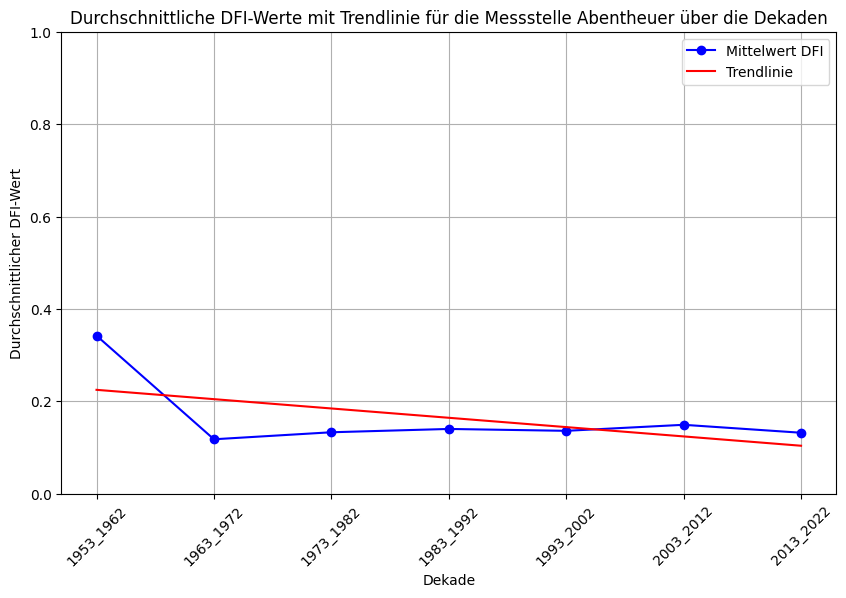

Steigung der Trendlinie: -0.02016766109288923
p-Wert der Trendlinie: 0.19915861259665235


In [18]:
import numpy as np
from scipy.stats import linregress

# Berechnen der linearen Regression
x = np.arange(len(mean_dfi_by_dekade))
slope, intercept, r_value, p_value, std_err = linregress(x, mean_dfi_by_dekade['abentheuer'])

# Plotten der Mittelwerte der DFI-Werte für jede Dekade mit Trendlinie
plt.figure(figsize=(10, 6))
plt.plot(mean_dfi_by_dekade['dekade'], mean_dfi_by_dekade['abentheuer'], marker='o', linestyle='-', color='b', label='Mittelwert DFI')
plt.plot(mean_dfi_by_dekade['dekade'], intercept + slope * x, 'r', label='Trendlinie')
plt.title('Durchschnittliche DFI-Werte mit Trendlinie für die Messstelle Abentheuer über die Dekaden')
plt.xlabel('Dekade')
plt.ylabel('Durchschnittlicher DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)
plt.grid(True)
plt.legend()
plt.show()

print(f"Steigung der Trendlinie: {slope}")
print(f"p-Wert der Trendlinie: {p_value}")


Für alle Messstellen

In [25]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

# Verzeichnis mit den Dekaden-Dateien
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join"

# Liste aller Dateien im Eingabeverzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.endswith('.xlsx')]

# DataFrame für die Messstelle Abentheuer
abentheuer_data = pd.DataFrame()

# Daten aus jeder Datei lesen und die Daten für Abentheuer sammeln
for datei in alle_dateien:
    # Datei einlesen
    dekade_df = pd.read_excel(datei)
    
    # Dekadenbereich aus dem Dateinamen extrahieren
    dekade = os.path.basename(datei).replace('dfi_join_', '').replace('.xlsx', '')
    
    # Daten für die Messstelle Abentheuer hinzufügen
    if 'abentheuer' in dekade_df.columns:
        temp_df = dekade_df[['n', 'abentheuer']].copy()
        temp_df['dekade'] = dekade
        abentheuer_data = pd.concat([abentheuer_data, temp_df], ignore_index=True)

# Berechnen der Mittelwerte der DFI-Werte für jede Dekade
mean_dfi_by_dekade = abentheuer_data.groupby('dekade')['abentheuer'].mean().reset_index()

# Berechnen der linearen Regression
x = np.arange(len(mean_dfi_by_dekade))
slope, intercept, r_value, p_value, std_err = linregress(x, mean_dfi_by_dekade['abentheuer'])

# Plotten der Mittelwerte der DFI-Werte für jede Dekade mit Trendlinie
plt.figure(figsize=(10, 6))
plt.plot(mean_dfi_by_dekade['dekade'], mean_dfi_by_dekade['abentheuer'], marker='o', linestyle='-', color='b', label='Mittelwert DFI')
plt.plot(mean_dfi_by_dekade['dekade'], intercept + slope * x, 'r', label='Trendlinie')

# Hinzufügen der Trendlinienformel und des p-Werts zum Plot
formula_text = f"y = {slope:.2f}x + {intercept:.2f}\np-Wert = {p_value:.4f}"
plt.text(0.05, 0.9, formula_text, transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

plt.title('Durchschnittliche DFI-Werte mit Trendlinie für die Messstelle Abentheuer über die Dekaden')
plt.xlabel('Dekade')
plt.ylabel('Durchschnittlicher DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)
plt.grid(False)
plt.legend()
plt.tight_layout()
plt.show()

print(f"Steigung der Trendlinie: {slope}")
print(f"p-Wert der Trendlinie: {p_value}")



Steigung der Trendlinie: 0.0032901599006824782
p-Wert der Trendlinie: 0.21326981418387558


Rumspielen mit Boxplots

<Figure size 1200x600 with 0 Axes>

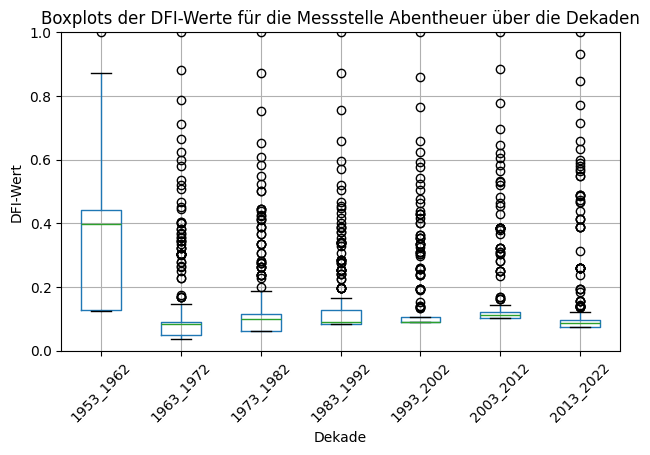

In [23]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress

# Verzeichnis mit den Dekaden-Dateien
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join"

# Liste aller Dateien im Eingabeverzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.endswith('.xlsx')]

# DataFrame für die Messstelle Abentheuer
abentheuer_data = pd.DataFrame()

# Daten aus jeder Datei lesen und die Daten für Abentheuer sammeln
for datei in alle_dateien:
    # Datei einlesen
    dekade_df = pd.read_excel(datei)
    
    # Dekadenbereich aus dem Dateinamen extrahieren
    dekade = os.path.basename(datei).replace('dfi_join_', '').replace('.xlsx', '')
    
    # Daten für die Messstelle Abentheuer hinzufügen
    if 'abentheuer' in dekade_df.columns:
        temp_df = dekade_df[['n', 'abentheuer']].copy()
        temp_df['dekade'] = dekade
        abentheuer_data = pd.concat([abentheuer_data, temp_df], ignore_index=True)

# Boxplots der DFI-Werte für jede Dekade erstellen
plt.figure(figsize=(12, 6))
abentheuer_data.boxplot(column='abentheuer', by='dekade', grid=False)
plt.title('Boxplots der DFI-Werte für die Messstelle Abentheuer über die Dekaden')
plt.suptitle('')  # Titel des Subplots entfernen
plt.xlabel('Dekade')
plt.ylabel('DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()


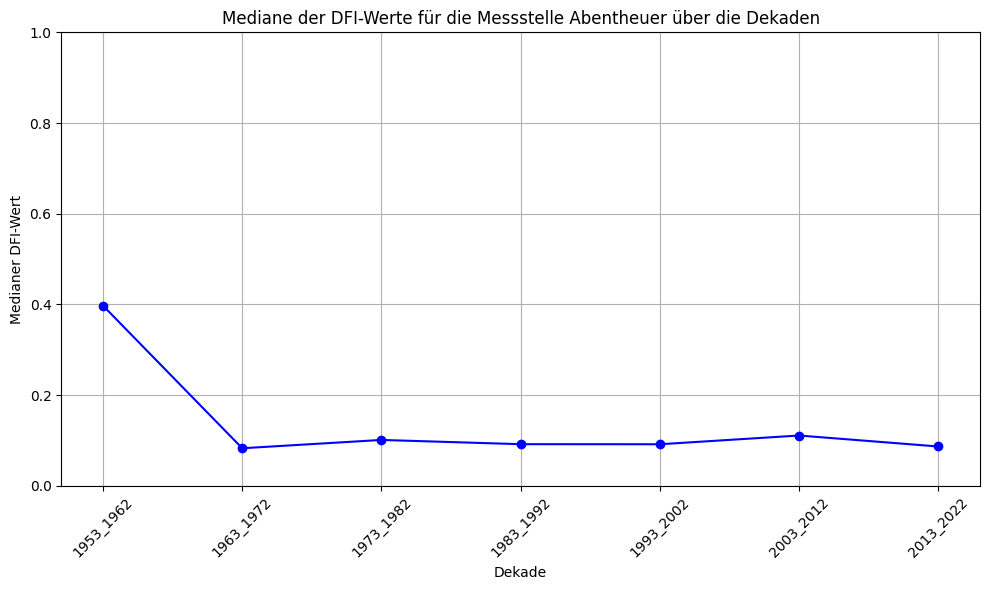

In [24]:
# Berechnen der Mediane der DFI-Werte für jede Dekade
median_dfi_by_dekade = abentheuer_data.groupby('dekade')['abentheuer'].median().reset_index()

# Plotten der Mediane der DFI-Werte für jede Dekade
plt.figure(figsize=(10, 6))
plt.plot(median_dfi_by_dekade['dekade'], median_dfi_by_dekade['abentheuer'], marker='o', linestyle='-', color='b')
plt.title('Mediane der DFI-Werte für die Messstelle Abentheuer über die Dekaden')
plt.xlabel('Dekade')
plt.ylabel('Medianer DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()


In [1]:
import os
import pandas as pd

# Verzeichnisse und Dateipfade
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10_join"
output_datei = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_transposed_dekaden.xlsx"

# Dekadenliste
dekaden = [
    "1933_1942", "1943_1952", "1953_1962", "1963_1972",
    "1973_1982", "1983_1992", "1993_2002", "2003_2012", "2013_2022"
]

# Liste aller relevanten Dateien im Eingabeverzeichnis
alle_dateien = [os.path.join(input_verzeichnis, f) for f in os.listdir(input_verzeichnis) if f.startswith('dfi_join') and f.endswith('.xlsx')]

# DataFrame zur Speicherung der transponierten Daten
df_transposed = pd.DataFrame(columns=['dekade', 'messstelle'] + list(range(1, 366)))

# Daten aus jeder Datei lesen und transponieren
for datei in alle_dateien:
    # Datei einlesen
    dekade_df = pd.read_excel(datei)
    
    # Dekadenbereich aus dem Dateinamen extrahieren
    dekade = os.path.basename(datei).replace('dfi_join_', '').replace('.xlsx', '')
    
    # Überprüfen, ob die Dekade in der Liste der Dekaden enthalten ist
    if dekade in dekaden:
        # Transponieren der Daten für jede Messstelle
        for col in dekade_df.columns:
            if col != 'n':
                temp_df = dekade_df[['n', col]].set_index('n').transpose()
                temp_df['dekade'] = dekade
                temp_df['messstelle'] = col
                df_transposed = pd.concat([df_transposed, temp_df], ignore_index=True)

# Sortieren der Spalten
df_transposed = df_transposed[['dekade', 'messstelle'] + list(range(1, 366))]

# Speichern der transponierten Daten
df_transposed.to_excel(output_datei, index=False)

print(f"Die transponierten Daten wurden erfolgreich in {output_datei} gespeichert.")


Die transponierten Daten wurden erfolgreich in C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_transposed_dekaden.xlsx gespeichert.


In [2]:
import pandas as pd

# Pfade zu den relevanten Dateien
dekaden_datei = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_transposed_dekaden.xlsx"
hierarchie_datei = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/merged_hierarchie_overview_updated.xlsx"

# Lesen der Dekaden-Daten
dekaden_df = pd.read_excel(dekaden_datei)

# Lesen der Hierarchie-Daten
hierarchie_df = pd.read_excel(hierarchie_datei)

# Überprüfen der Spaltennamen
print("Spalten der Dekaden-Datei:", dekaden_df.columns)
print("Spalten der Hierarchie-Datei:", hierarchie_df.columns)

# Umbenennen der Spalten in der Hierarchie-Datei, falls erforderlich
hierarchie_df = hierarchie_df.rename(columns={
    'ezg_fluss_1': 'ezg_fluss'
})

# Überprüfen der einzigartigen Werte der 'messstelle'
print("Einzigartige Werte in 'messstelle' der Dekaden-Datei:", dekaden_df['messstelle'].unique())
print("Einzigartige Werte in 'messstelle' der Hierarchie-Datei:", hierarchie_df['messstelle'].unique())

# Sicherstellen, dass alle 'messstelle'-Namen in beiden DataFrames übereinstimmen
missing_messstellen = set(dekaden_df['messstelle'].unique()) - set(hierarchie_df['messstelle'].unique())
print("Messstellen in Dekaden-Datei, aber nicht in Hierarchie-Datei:", missing_messstellen)

# Neue Spalten initialisieren
dekaden_df['ezg_fluss'] = None
dekaden_df['ezg_name'] = None
dekaden_df['ezg_id'] = None
dekaden_df['cluster'] = None

# Informationen aus der Hierarchie-Datei in die Dekaden-Datei einfügen
for index, row in dekaden_df.iterrows():
    messstelle = row['messstelle']
    hierarchie_info = hierarchie_df[hierarchie_df['messstelle'] == messstelle]
    
    if not hierarchie_info.empty:
        dekaden_df.at[index, 'ezg_fluss'] = hierarchie_info['ezg_fluss'].values[0]
        dekaden_df.at[index, 'ezg_name'] = hierarchie_info['ezg_name'].values[0]
        dekaden_df.at[index, 'ezg_id'] = hierarchie_info['ezg_id'].values[0]
        dekaden_df.at[index, 'cluster'] = hierarchie_info['cluster'].values[0]

# Ergebnis speichern
output_datei = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_transposed_dekaden_merged.xlsx"
dekaden_df.to_excel(output_datei, index=False)

print(f"Die Daten wurden erfolgreich unter {output_datei} gespeichert.")


Spalten der Dekaden-Datei: Index([    'dekade', 'messstelle',            1,            2,            3,
                  4,            5,            6,            7,            8,
       ...
                356,          357,          358,          359,          360,
                361,          362,          363,          364,          365],
      dtype='object', length=367)
Spalten der Hierarchie-Datei: Index(['ezg_fluss_1', 'ezg_name', 'messstelle', 'ezg_id', 'ezg_kat',
       'unter_ezg_nr', 'messst-nr', 'rechtswert', 'hochwert', 'erstes_datum',
       'letztes_datum', 'gewaesser', 'stromgebiet', 'area',
       'pegelnullpunkt_m_ue_nhn', 'cluster'],
      dtype='object')
Einzigartige Werte in 'messstelle' der Dekaden-Datei: ['index' 'friedrichsthal' 'neustadt' 'altenahr' 'alsdorf' 'altenbamberg'
 'betzdorf' 'bobenthal' 'boos' 'contwig' 'heimborn' 'imsweiler' 'nettegut'
 'odenbach' 'papiermuehle' 'planig' 'untersulzbach' 'abentheuer'
 'albisheim' 'althornbach' 'argenschwang' 'boll

Festlegung der Farben je cluster: 
colorblind_palette = sns.color_palette("colorblind")
selected_colors = [colorblind_palette[i] for i in [0, 1, 2, 3]]  # Blau, Orange, Grün, Rot

Blau (#0072B2)
Orange (#E69F00)
Grün (#009E73)
Rot (#D55E00)

### Analysis CDCs Dekaden

Spaltennamen im DataFrame: Index([    'dekade', 'messstelle',          'n',            1,            2,
                  3,            4,            5,            6,            7,
       ...
                355,          356,          357,          358,          359,
                360,  'ezg_fluss',   'ezg_name',     'ezg_id',    'cluster'],
      dtype='object', length=367)
DFI-Spalten: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143

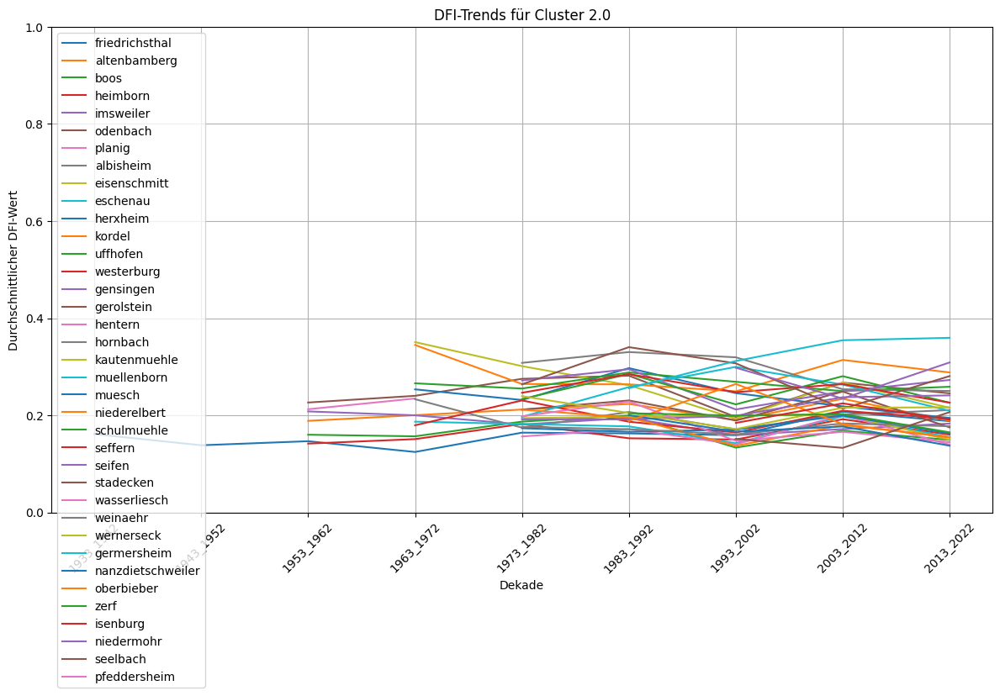

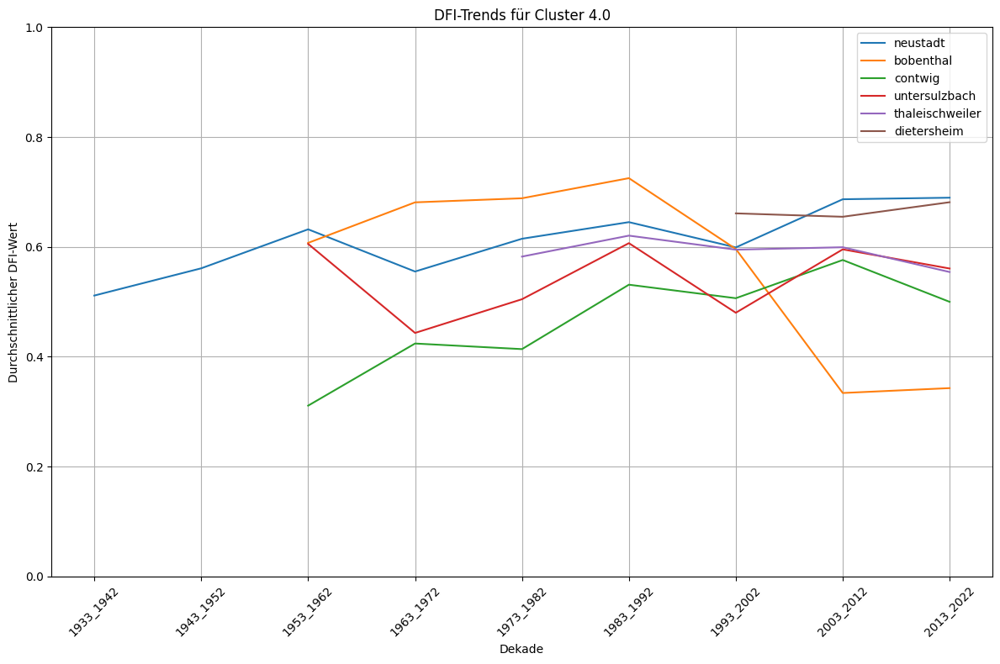

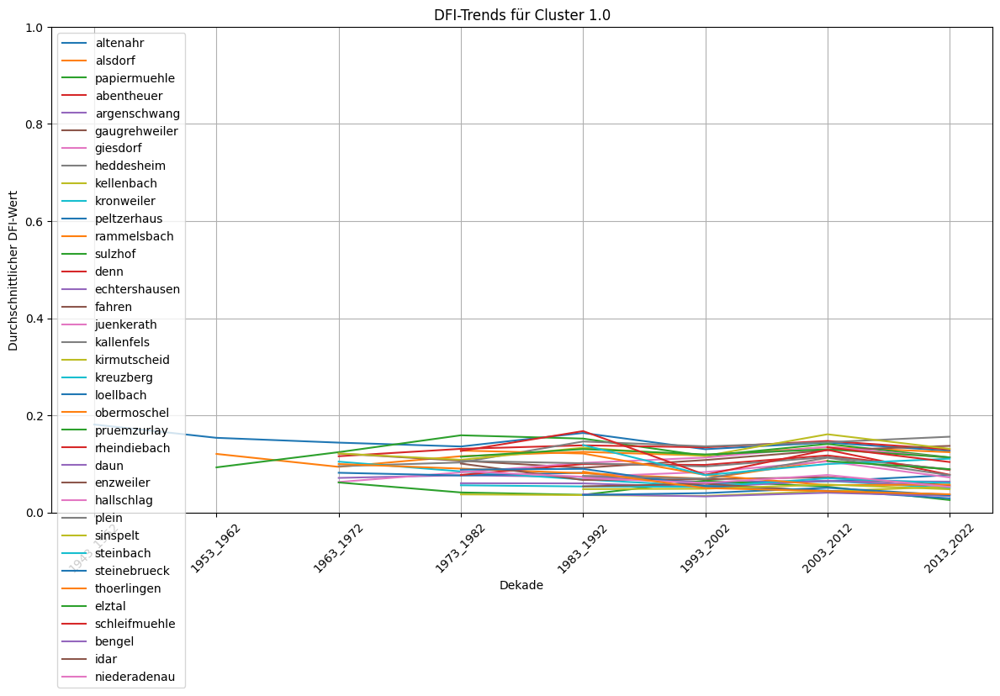

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


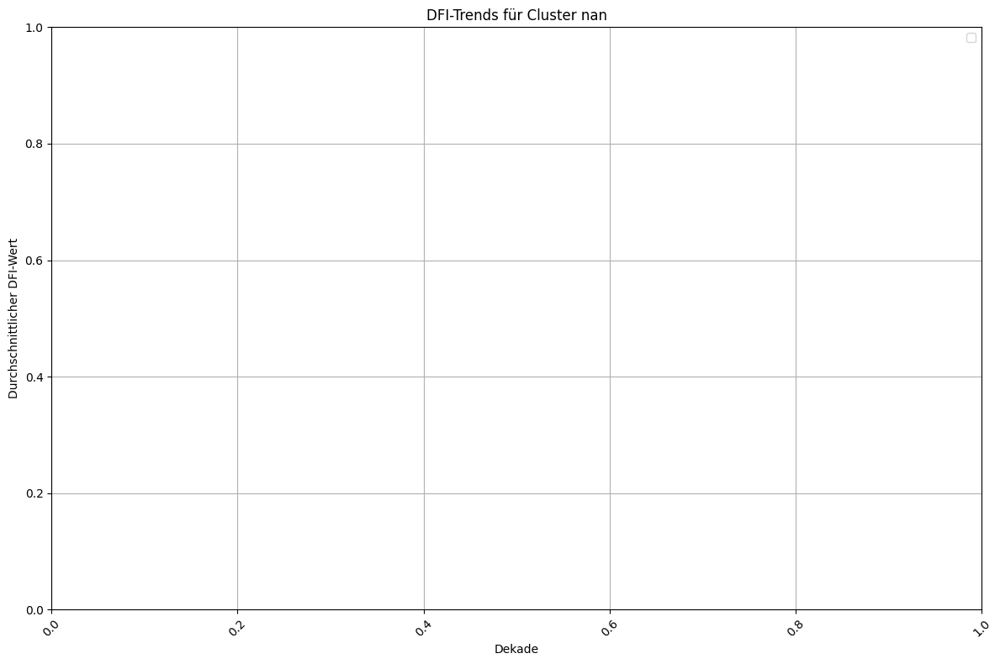

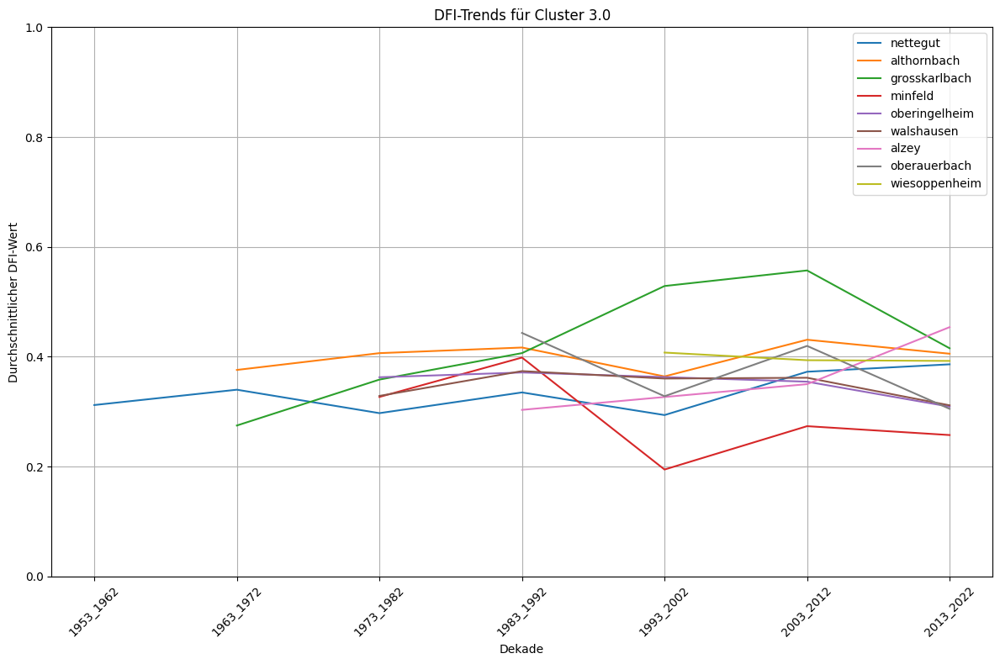

In [64]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress
import seaborn as sns

# Farben für die Plots
cluster_colors = {
    1: '#0072B2',  # Blau
    2: '#E69F00',  # Orange
    3: '#009E73',  # Grün
    4: '#D55E00'   # Rot
}

# Cluster-Daten laden
cluster_data_path = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx"
cluster_df = pd.read_excel(cluster_data_path)

# Anzeigen der tatsächlichen Spaltennamen
print("Spaltennamen im DataFrame:", cluster_df.columns)

# Sicherstellen, dass die Spaltennamen korrekt sind
dfi_spalten = list(range(1, 361))
print("DFI-Spalten:", dfi_spalten)

# Überprüfen, ob die DFI-Spalten im DataFrame vorhanden sind
missing_spalten = [spalte for spalte in dfi_spalten if spalte not in cluster_df.columns]
if missing_spalten:
    print("Fehlende DFI-Spalten:", missing_spalten)
else:
    print("Alle DFI-Spalten sind vorhanden.")

# Funktion zur Erstellung der Plots
def plot_cluster_trends(cluster):
    cluster_messstellen = cluster_df[cluster_df['cluster'] == cluster]['messstelle'].unique()
    plt.figure(figsize=(12, 8))
    
    for messstelle in cluster_messstellen:
        messstelle_data = cluster_df[cluster_df['messstelle'] == messstelle]
        dekaden = messstelle_data['dekade'].values
        dfi_values = messstelle_data[dfi_spalten].mean(axis=1).values
        
        # Plotten der DFI-Werte für jede Messstelle
        plt.plot(dekaden, dfi_values, label=messstelle)
    
    plt.title(f'DFI-Trends für Cluster {cluster}')
    plt.xlabel('Dekade')
    plt.ylabel('Durchschnittlicher DFI-Wert')
    plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

# Plots für jeden Cluster erstellen
for cluster in cluster_df['cluster'].unique():
    plot_cluster_trends(cluster)


Lineare Regression um signifikante Änderungen herauszufinden

In [74]:
import pandas as pd

# Pfad zu den Daten
data_path = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx"

# Daten laden
df = pd.read_excel(data_path)

# Überprüfen der Spaltennamen
print("Spalten im DataFrame:", df.columns)

# Beispielhafte Anzeige der ersten Zeilen, um sicherzustellen, dass die Daten korrekt geladen werden
print(df.head())

# DFI-Spalten identifizieren
dfi_spalten = [str(i) for i in range(1, 361)]
print("DFI-Spalten:", dfi_spalten)

# Überprüfen, ob alle DFI-Spalten im DataFrame vorhanden sind
missing_spalten = [spalte for spalte in dfi_spalten if spalte not in df.columns]
print("Fehlende DFI-Spalten:", missing_spalten)


Spalten im DataFrame: Index([    'dekade', 'messstelle',          'n',            1,            2,
                  3,            4,            5,            6,            7,
       ...
                355,          356,          357,          358,          359,
                360,  'ezg_fluss',   'ezg_name',     'ezg_id',    'cluster'],
      dtype='object', length=367)
      dekade      messstelle  n         1         2         3         4  \
0  1933_1942  friedrichsthal  1  0.777408  0.626827  0.573816  0.538967   
1  1933_1942        neustadt  1  0.974288  0.928916  0.890756  0.865558   
2  1943_1952        altenahr  1  0.810506  0.703677  0.657130  0.611730   
3  1943_1952  friedrichsthal  1  0.795480  0.653074  0.547470  0.500551   
4  1943_1952        neustadt  1  0.972138  0.933983  0.907578  0.886164   

          5         6         7  ...       355       356       357       358  \
0  0.494985  0.461923  0.438831  ...  0.111257  0.111257  0.111257  0.111257   
1  0.848060  

In [76]:
import os
import pandas as pd
import numpy as np
from scipy.stats import linregress

# Pfad zur Daten
data_path = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx"

# Daten laden
df = pd.read_excel(data_path)

# DFI-Spalten identifizieren
dfi_spalten = list(range(1, 361))

# Ergebnisse der linearen Regressionen speichern
regression_results = []

# Für jede Messstelle lineare Regression berechnen
for messstelle in df['messstelle'].unique():
    messstelle_data = df[df['messstelle'] == messstelle]
    dekaden = np.arange(len(messstelle_data))
    mean_dfi_values = messstelle_data[dfi_spalten].mean(axis=1)
    
    # Lineare Regression
    slope, intercept, r_value, p_value, std_err = linregress(dekaden, mean_dfi_values)
    
    regression_results.append({
        'messstelle': messstelle,
        'slope': slope,
        'intercept': intercept,
        'r_value': r_value,
        'p_value': p_value,
        'std_err': std_err
    })

# Ergebnisse in DataFrame umwandeln
regression_df = pd.DataFrame(regression_results)

# Ergebnisse speichern
output_path = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/regression_results.xlsx"
regression_df.to_excel(output_path, index=False)

# Nur signifikante Ergebnisse anzeigen
significant_results = regression_df[regression_df['p_value'] < 0.05]

# Ausgabe der signifikanten Ergebnisse
print(significant_results)


        messstelle     slope  intercept   r_value   p_value   std_err
0   friedrichsthal  0.006282   0.136160  0.691491  0.039084  0.002480
1         neustadt  0.018564   0.536273  0.841512  0.004453  0.004504
2         altenahr -0.005255   0.165657 -0.707188  0.049787  0.002145
8          contwig  0.034416   0.362859  0.834049  0.019663  0.010181
14          planig  0.022129   0.212467  1.000000  0.000000  0.000000
26      heddesheim  0.011970   0.100153  0.895302  0.015869  0.002978
30      kronweiler -0.009851   0.095562 -0.903818  0.013432  0.002332
48       loellbach -0.016333   0.093777 -0.959741  0.009638  0.002760
54     obermoschel -0.020538   0.128861 -0.944161  0.015706  0.004138
59          seifen  0.014455   0.183101  0.916565  0.028566  0.003641
86          elztal -0.016737   0.105739 -1.000000  0.000000  0.000000
87   schleifmuehle -0.030315   0.134064 -1.000000  0.000000  0.000000


c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in scalar divide
  slope = ssxym / ssxm
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:199: RuntimeWarning: invalid value encountered in scalar divide
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in scalar divide
  slope = ssxym / ssxm
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encoun

In [90]:
import pandas as pd

# Pfad zur Datei mit den DFI-Daten
data_path = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx"
df = pd.read_excel(data_path)

# Überprüfen der ersten Zeilen des DataFrames
print("Erste Zeilen des DataFrames:")
print(df.head())

# Überprüfen der Spaltennamen
print("\nSpaltennamen im DataFrame:")
print(df.columns)



Erste Zeilen des DataFrames:
      dekade      messstelle  n         1         2         3         4  \
0  1933_1942  friedrichsthal  1  0.777408  0.626827  0.573816  0.538967   
1  1933_1942        neustadt  1  0.974288  0.928916  0.890756  0.865558   
2  1943_1952        altenahr  1  0.810506  0.703677  0.657130  0.611730   
3  1943_1952  friedrichsthal  1  0.795480  0.653074  0.547470  0.500551   
4  1943_1952        neustadt  1  0.972138  0.933983  0.907578  0.886164   

          5         6         7  ...       355       356       357       358  \
0  0.494985  0.461923  0.438831  ...  0.111257  0.111257  0.111257  0.111257   
1  0.848060  0.827558  0.820715  ...  0.403971  0.403971  0.403971  0.403971   
2  0.590077  0.544061  0.529152  ...  0.109373  0.109373  0.109373  0.109373   
3  0.482223  0.451563  0.421835  ...  0.089676  0.089676  0.089676  0.089676   
4  0.874413  0.865406  0.855528  ...  0.495598  0.495598  0.495598  0.495598   

        359       360    ezg_fluss    e

In [91]:
# Prüfen, ob die Spaltennamen als Zahlen eingelesen wurden, und konvertieren zu Strings
df.columns = df.columns.astype(str)

# Erneute Überprüfung der Spaltennamen nach Konvertierung
print("\nKonvertierte Spaltennamen im DataFrame:")
print(df.columns)



Konvertierte Spaltennamen im DataFrame:
Index(['dekade', 'messstelle', 'n', '1', '2', '3', '4', '5', '6', '7',
       ...
       '355', '356', '357', '358', '359', '360', 'ezg_fluss', 'ezg_name',
       'ezg_id', 'cluster'],
      dtype='object', length=367)


In [92]:
# DFI-Spalten identifizieren und sicherstellen, dass sie als Strings vorliegen
dfi_spalten = list(map(str, range(1, 361)))

# Überprüfen, ob alle DFI-Spalten vorhanden sind
missing_spalten = [col for col in dfi_spalten if col not in df.columns]
if missing_spalten:
    print(f"Fehlende DFI-Spalten: {missing_spalten}")
else:
    print("Alle DFI-Spalten sind vorhanden.")


Alle DFI-Spalten sind vorhanden.


In [93]:
import numpy as np
from scipy.stats import linregress

# Lineare Regression für jede Messstelle
regression_results = []
for messstelle in df['messstelle'].unique():
    messstelle_data = df[df['messstelle'] == messstelle]
    dekaden = np.arange(len(messstelle_data))
    mean_dfi_values = messstelle_data[dfi_spalten].astype(float).mean(axis=1)
    
    # Lineare Regression
    slope, intercept, r_value, p_value, std_err = linregress(dekaden, mean_dfi_values)
    
    regression_results.append({
        'messstelle': messstelle,
        'slope': slope,
        'intercept': intercept,
        'r_value': r_value,
        'p_value': p_value,
        'std_err': std_err
    })

# Ergebnisse in DataFrame umwandeln
regression_df = pd.DataFrame(regression_results)

# Nur signifikante Ergebnisse anzeigen
significant_results = regression_df[regression_df['p_value'] < 0.05]

# Ausgabe der signifikanten Ergebnisse
print("Signifikante Ergebnisse:")
print(significant_results)


Signifikante Ergebnisse:
        messstelle     slope  intercept   r_value   p_value   std_err
0   friedrichsthal  0.006282   0.136160  0.691491  0.039084  0.002480
1         neustadt  0.018564   0.536273  0.841512  0.004453  0.004504
2         altenahr -0.005255   0.165657 -0.707188  0.049787  0.002145
8          contwig  0.034416   0.362859  0.834049  0.019663  0.010181
14          planig  0.022129   0.212467  1.000000  0.000000  0.000000
26      heddesheim  0.011970   0.100153  0.895302  0.015869  0.002978
30      kronweiler -0.009851   0.095562 -0.903818  0.013432  0.002332
48       loellbach -0.016333   0.093777 -0.959741  0.009638  0.002760
54     obermoschel -0.020538   0.128861 -0.944161  0.015706  0.004138
59          seifen  0.014455   0.183101  0.916565  0.028566  0.003641
86          elztal -0.016737   0.105739 -1.000000  0.000000  0.000000
87   schleifmuehle -0.030315   0.134064 -1.000000  0.000000  0.000000


c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in scalar divide
  slope = ssxym / ssxm
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encountered in sqrt
  t = r * np.sqrt(df / ((1.0 - r + TINY)*(1.0 + r + TINY)))
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:199: RuntimeWarning: invalid value encountered in scalar divide
  slope_stderr = np.sqrt((1 - r**2) * ssym / ssxm / df)
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:182: RuntimeWarning: invalid value encountered in scalar divide
  slope = ssxym / ssxm
c:\Users\Lenovo\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_stats_mstats_common.py:196: RuntimeWarning: invalid value encoun

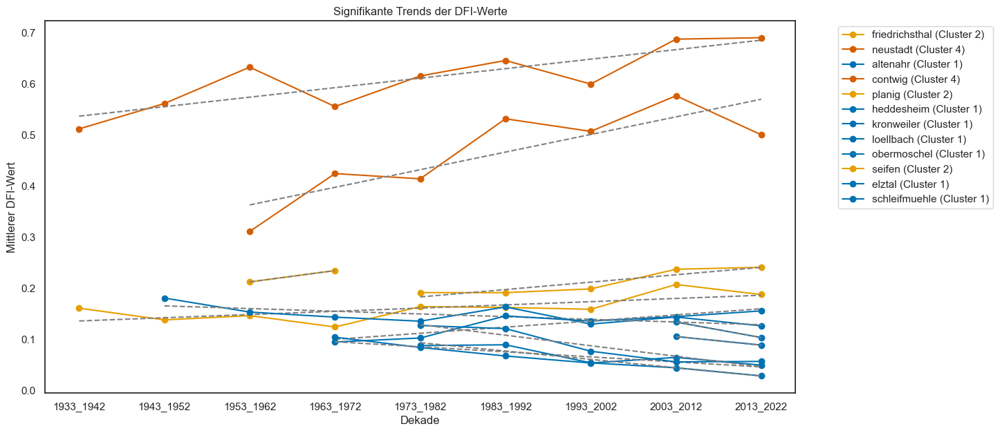

In [98]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_significant_trends(results):
    sns.set(style="white")
    plt.figure(figsize=(14, 7))

    colorblind_palette = sns.color_palette("colorblind")
    selected_colors = [colorblind_palette[i] for i in [0, 1, 2, 3]]
    cluster_colors = {
        1: '#0072B2',  # Blau
        2: '#E69F00',  # Orange
        3: '#009E73',  # Grün
        4: '#D55E00'   # Rot
    }

    for _, row in results.iterrows():
        messstelle = row['messstelle']
        slope = row['slope']
        intercept = row['intercept']
        cluster = int(df[df['messstelle'] == messstelle]['cluster'].iloc[0])  # Convert to int for no decimal places
        color = cluster_colors.get(cluster, 'gray')

        messstelle_data = df[df['messstelle'] == messstelle]
        dekaden = messstelle_data['dekade']
        mean_dfi_values = messstelle_data[dfi_spalten].astype(float).mean(axis=1)

        # Plotten der DFI-Werte und der Trendlinie
        plt.plot(dekaden, mean_dfi_values, marker='o', linestyle='-', label=f"{messstelle} (Cluster {cluster})", color=color)
        plt.plot(dekaden, intercept + slope * np.arange(len(dekaden)), linestyle='--', color='grey')

    plt.xlabel('Dekade')
    plt.ylabel('Mittlerer DFI-Wert')
    plt.title('Signifikante Trends der DFI-Werte')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.show()

# Plotten der Trends
plot_significant_trends(significant_results)



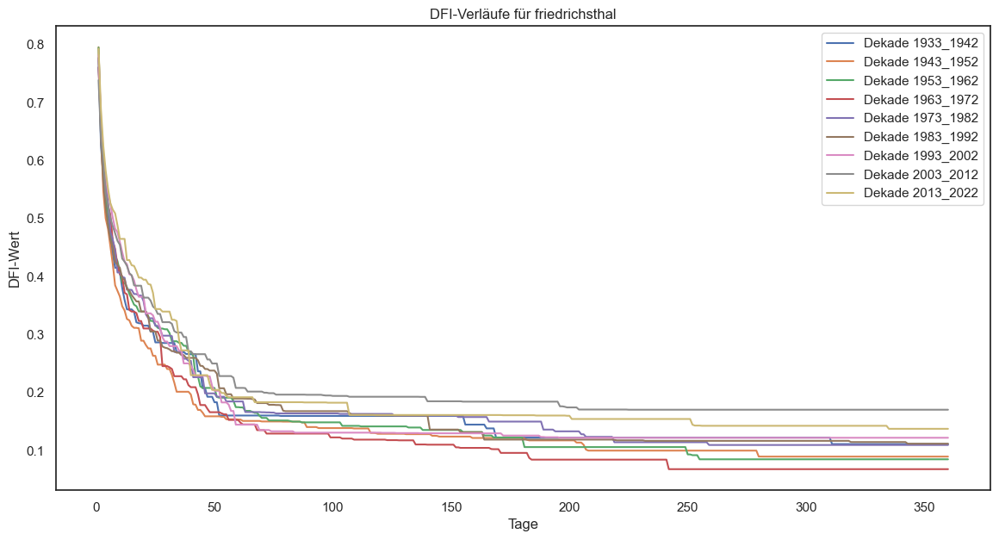

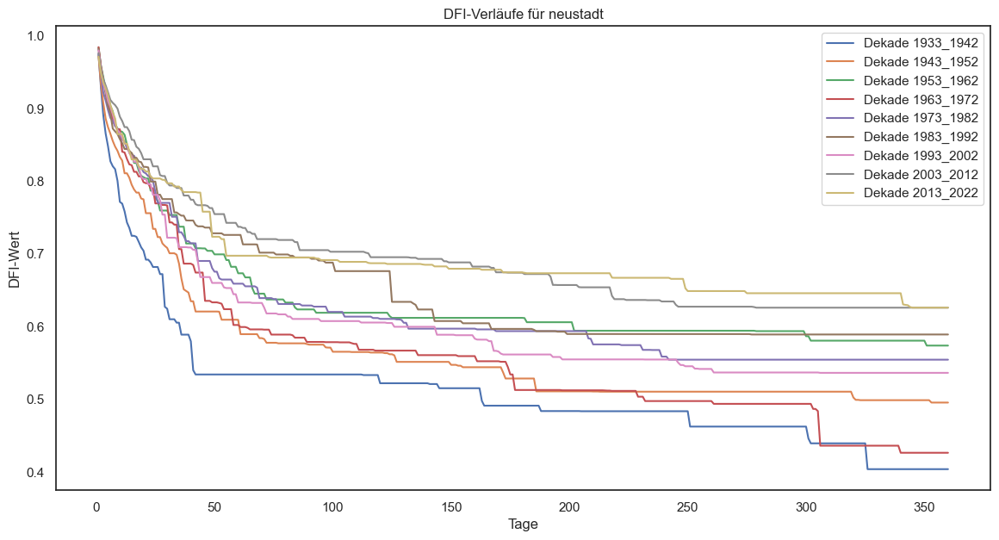

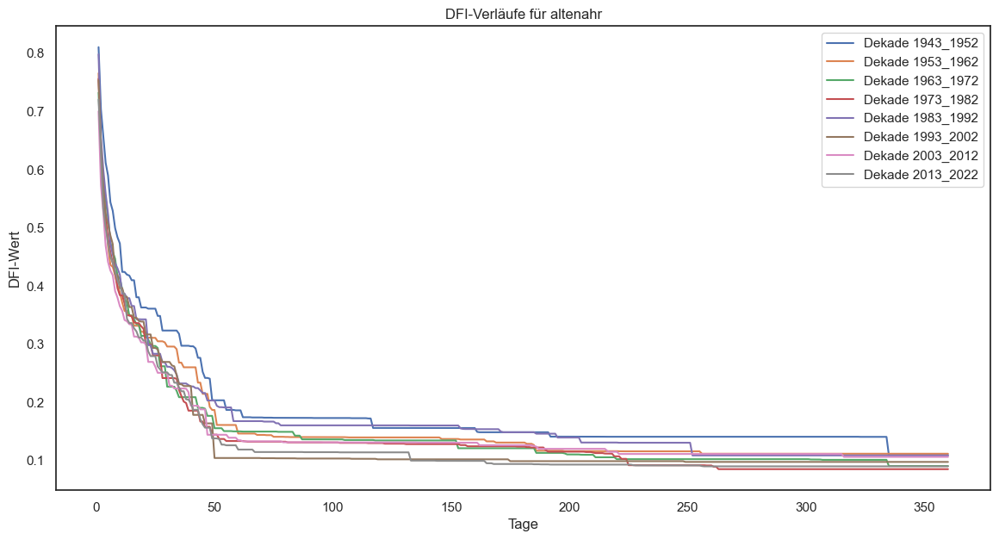

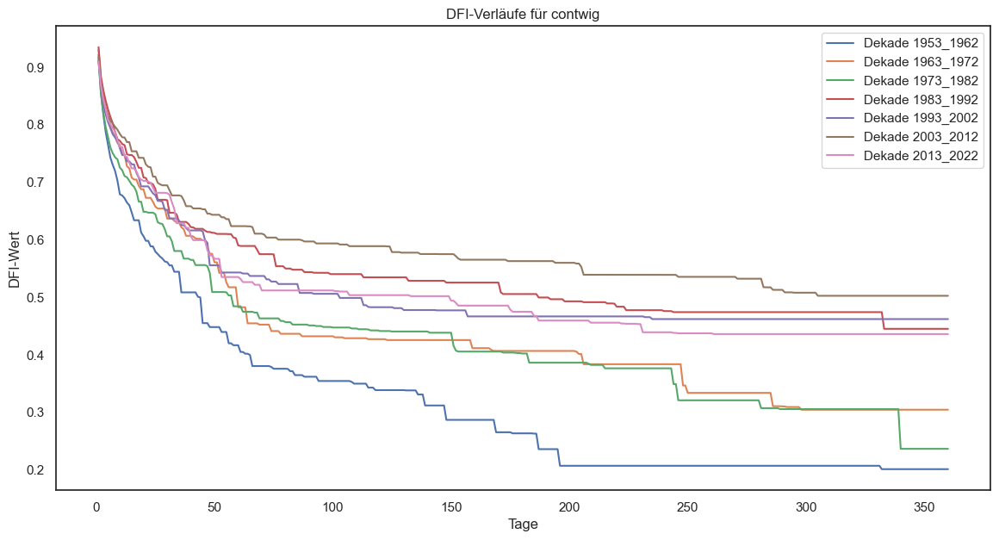

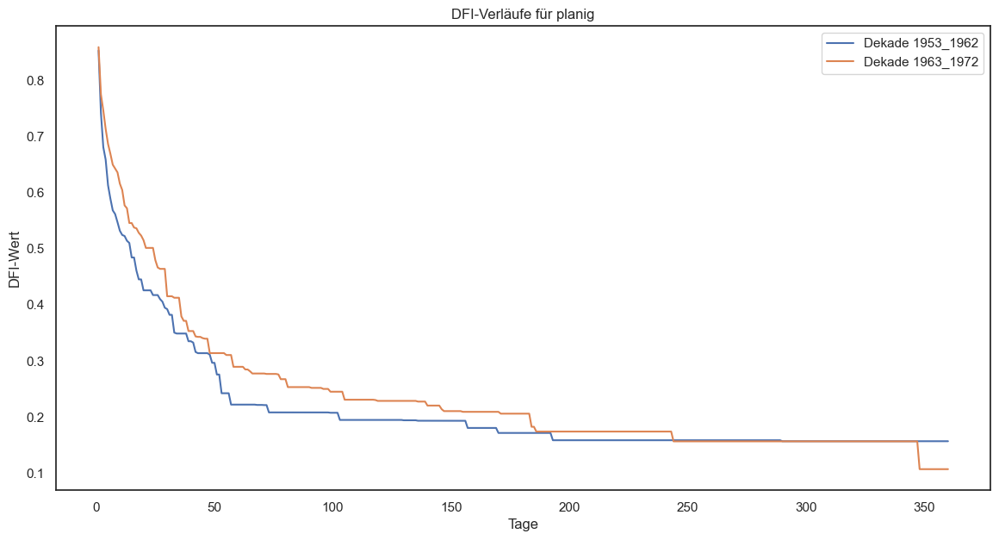

...

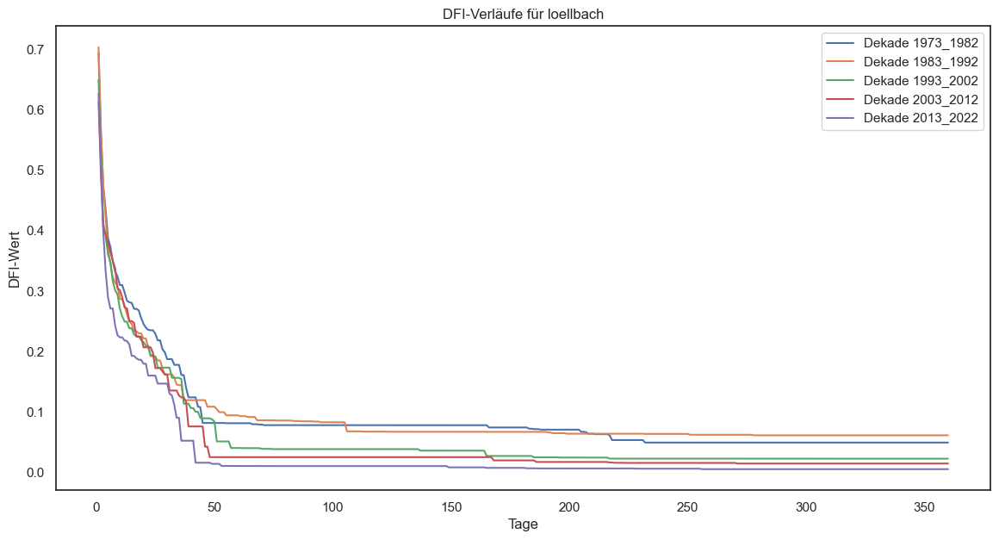

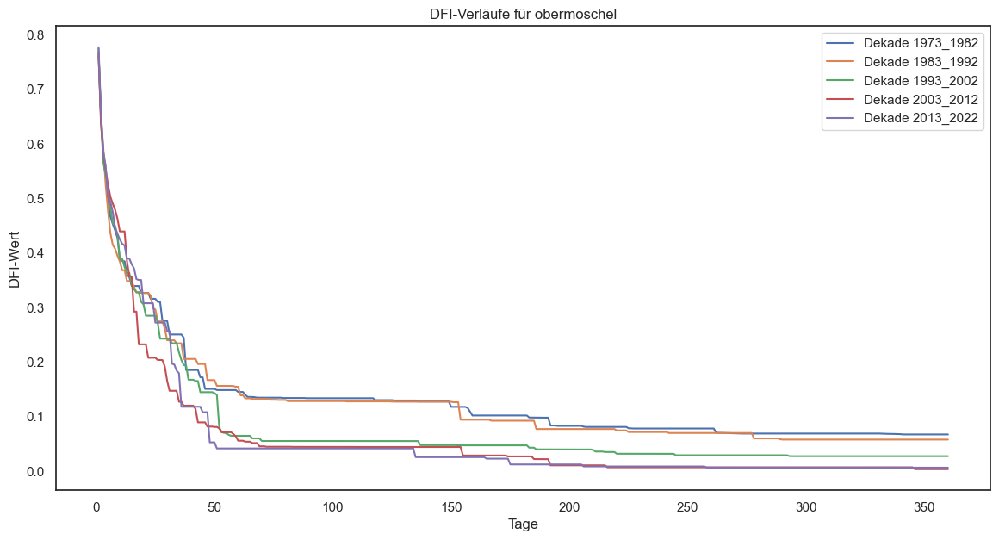

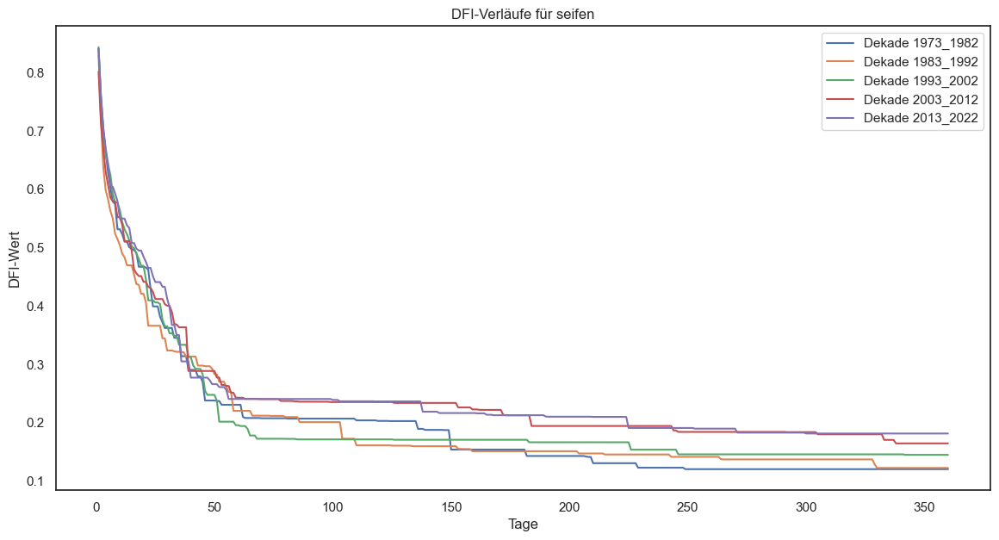

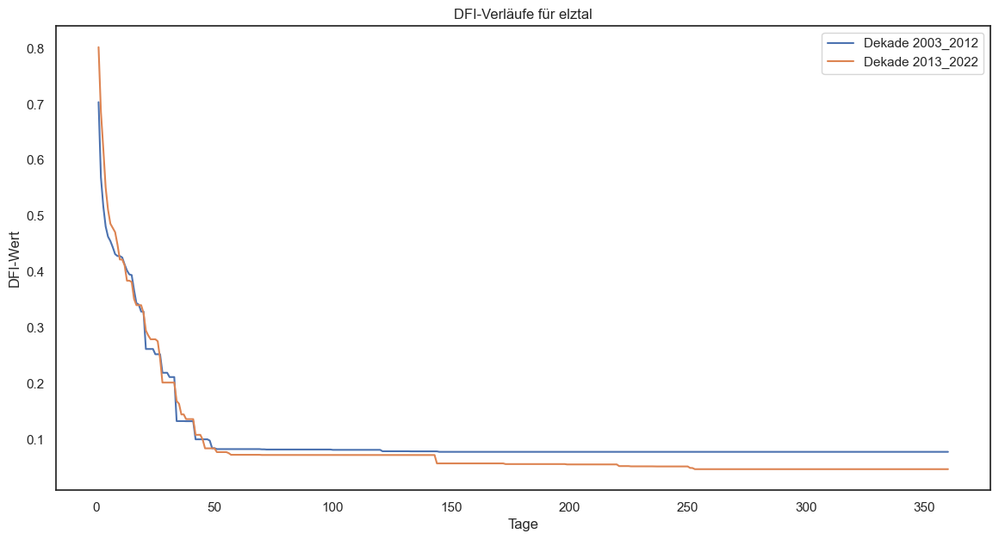

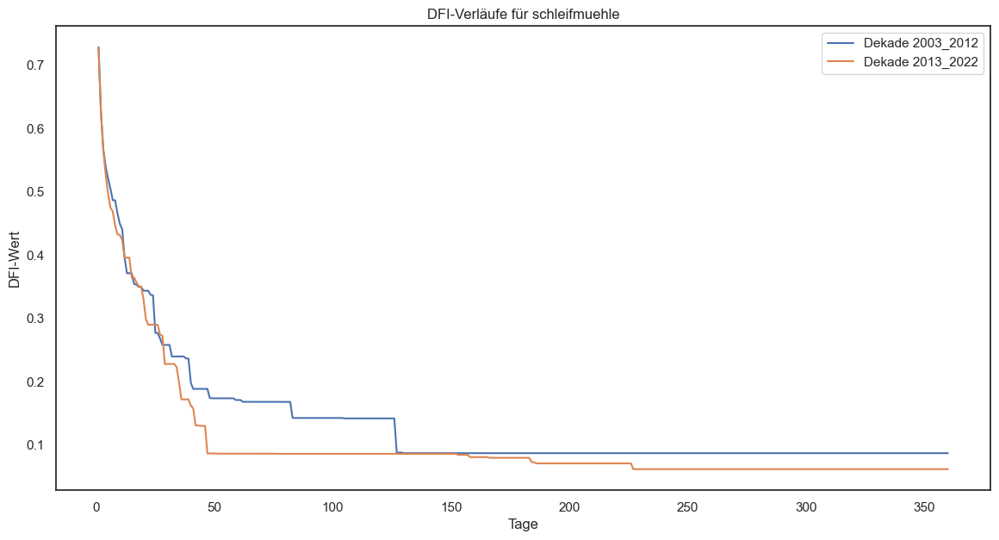

In [100]:
import matplotlib.pyplot as plt
import pandas as pd

# Erstellen einer Liste der 12 Messstellen
messstellen = [
    'friedrichsthal', 'neustadt', 'altenahr', 'contwig', 'planig', 
    'heddesheim', 'kronweiler', 'loellbach', 'obermoschel', 
    'seifen', 'elztal', 'schleifmuehle'
]

# Daten laden
data_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx'
df = pd.read_excel(data_path)

# DFI-Spalten identifizieren
dfi_spalten = list(range(1, 361))

# Für jede Messstelle einen Plot erstellen
for messstelle in messstellen:
    messstelle_data = df[df['messstelle'] == messstelle]
    dekaden = messstelle_data['dekade']
    dfi_values = messstelle_data[dfi_spalten].T
    
    plt.figure(figsize=(14, 7))
    for i, dekade in enumerate(dekaden):
        plt.plot(dfi_values.index, dfi_values.iloc[:, i], label=f'Dekade {dekade}')
    
    plt.xlabel('Tage')
    plt.ylabel('DFI-Wert')
    plt.title(f'DFI-Verläufe für {messstelle}')
    plt.legend(loc='upper right')
    plt.show()


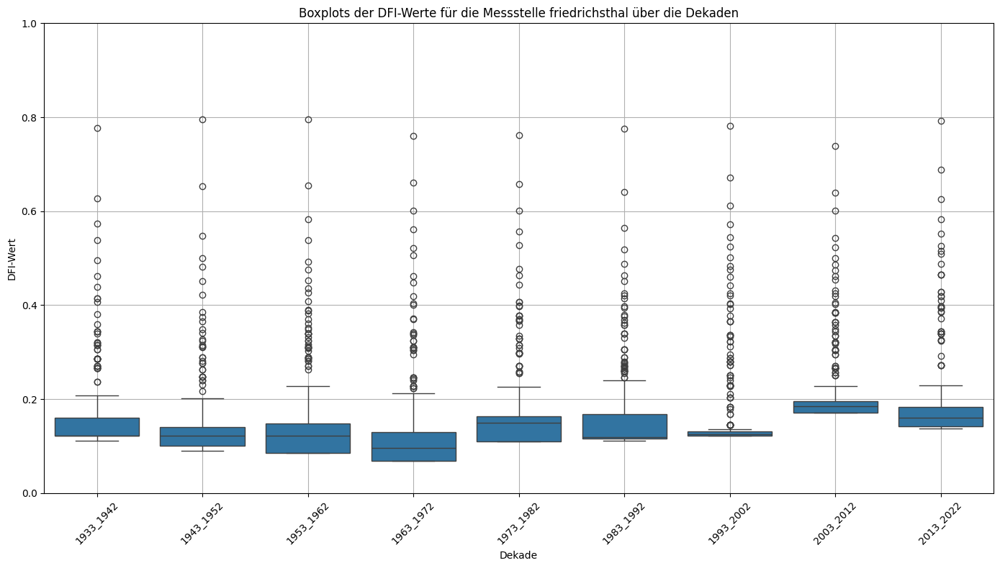

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Daten einlesen
data_path = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx"
df = pd.read_excel(file_path)

# Beispiel-Messstelle für die Analyse
messstelle = 'friedrichsthal'  # Ändern Sie den Namen der Messstelle entsprechend

# Filtern der Daten für die Messstelle
df_filtered = df[df['messstelle'] == messstelle]

# Konvertieren der DFI-Werte in numerische Werte
df_filtered.iloc[:, 3:] = df_filtered.iloc[:, 3:].apply(pd.to_numeric, errors='coerce')

# Daten für Boxplots vorbereiten
df_melted = df_filtered.melt(id_vars=['dekade', 'messstelle', 'n'], var_name='Tag', value_name='DFI-Wert')

# Boxplots der DFI-Werte für jede Dekade erstellen
plt.figure(figsize=(14, 8))
sns.boxplot(x='dekade', y='DFI-Wert', data=df_melted)
plt.title(f'Boxplots der DFI-Werte für die Messstelle {messstelle} über die Dekaden')
plt.xlabel('Dekade')
plt.ylabel('DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()


Vor dem Entfernen von NaN-Werten:
      dekade  DFI-Wert
0  1933_1942  0.166295
1  1943_1952  0.143415
2  1953_1962  0.151742
3  1963_1972  0.129619
4  1973_1982  0.169318
5  1983_1992  0.167746
6  1993_2002  0.164074
7  2003_2012  0.212362
8  2013_2022  0.192848
Nach dem Entfernen von NaN-Werten:
      dekade  DFI-Wert
0  1933_1942  0.166295
1  1943_1952  0.143415
2  1953_1962  0.151742
3  1963_1972  0.129619
4  1973_1982  0.169318
5  1983_1992  0.167746
6  1993_2002  0.164074
7  2003_2012  0.212362
8  2013_2022  0.192848
Dekaden als numerische Werte: [0 1 2 3 4 5 6 7 8]
Mittlere DFI-Werte: [0.16629458 0.1434145  0.15174217 0.12961857 0.1693175  0.1677465
 0.16407403 0.21236162 0.19284804]


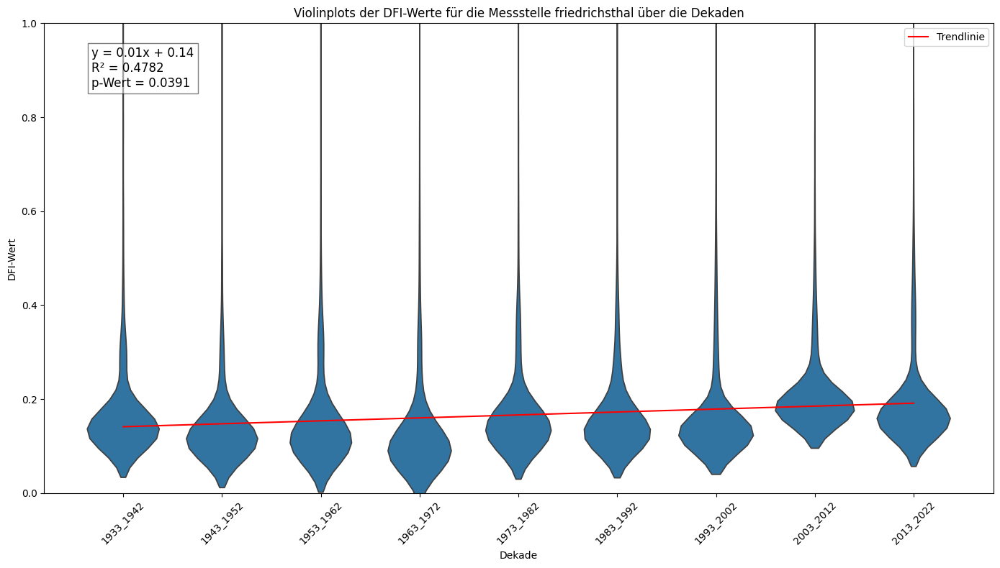

Steigung der Trendlinie: 0.006264114252667907
R² der Trendlinie: 0.47815951554028097
p-Wert der Trendlinie: 0.03908421820469089


In [14]:

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import linregress

# Laden der Excel-Datei
file_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx'
df = pd.read_excel(file_path)

# Beispiel-Messstelle für die Analyse
messstelle = 'friedrichsthal'

# Filtern der Daten für die Messstelle
df_filtered = df[df['messstelle'] == messstelle]

# Konvertieren der DFI-Werte in numerische Werte
df_filtered.iloc[:, 3:] = df_filtered.iloc[:, 3:].apply(pd.to_numeric, errors='coerce')

# Daten für Violinplots vorbereiten
df_melted = df_filtered.melt(id_vars=['dekade', 'messstelle', 'n'], var_name='Tag', value_name='DFI-Wert')

# Berechnen der mittleren DFI-Werte pro Dekade
mean_dfi_by_dekade = df_melted.groupby('dekade')['DFI-Wert'].mean().reset_index()

# Überprüfen auf NaN-Werte und diese entfernen
print("Vor dem Entfernen von NaN-Werten:")
print(mean_dfi_by_dekade)

mean_dfi_by_dekade = mean_dfi_by_dekade.dropna()

print("Nach dem Entfernen von NaN-Werten:")
print(mean_dfi_by_dekade)

# Konvertieren in numpy-Arrays und sicherstellen, dass sie keine NaN-Werte enthalten
dekade_nums = np.arange(len(mean_dfi_by_dekade))
mean_dfi_values = mean_dfi_by_dekade['DFI-Wert'].astype(float).values  # Sicherstellen, dass die Werte numerisch sind

print("Dekaden als numerische Werte:", dekade_nums)
print("Mittlere DFI-Werte:", mean_dfi_values)

# Überprüfen der Daten vor der Regression
assert not np.any(np.isnan(dekade_nums)), "dekade_nums enthält NaN-Werte"
assert not np.any(np.isnan(mean_dfi_values)), "mean_dfi_values enthält NaN-Werte"
assert np.issubdtype(dekade_nums.dtype, np.number), "dekade_nums ist nicht numerisch"
assert np.issubdtype(mean_dfi_values.dtype, np.number), "mean_dfi_values ist nicht numerisch"

# Berechnen der linearen Regression
slope, intercept, r_value, p_value, std_err = linregress(dekade_nums, mean_dfi_values)

# Plotten der Violinplots
plt.figure(figsize=(14, 8))
sns.violinplot(x='dekade', y='DFI-Wert', data=df_melted, inner=None)
plt.title(f'Violinplots der DFI-Werte für die Messstelle {messstelle} über die Dekaden')
plt.xlabel('Dekade')
plt.ylabel('DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)

# Plot der Regressionslinie
plt.plot(mean_dfi_by_dekade['dekade'], intercept + slope * dekade_nums, 'r', label='Trendlinie')

# Hinzufügen der Regressionsformel, R² und p-Wert zum Plot
r_squared = r_value**2
formula_text = f'y = {slope:.2f}x + {intercept:.2f}\nR² = {r_squared:.4f}\np-Wert = {p_value:.4f}'
plt.text(0.05, 0.95, formula_text, transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

plt.legend()
plt.tight_layout()
plt.show()

print(f"Steigung der Trendlinie: {slope}")
print(f"R² der Trendlinie: {r_squared}")
print(f"p-Wert der Trendlinie: {p_value}")


Violinplots mit Lin-reg der letzen 40 Jahre

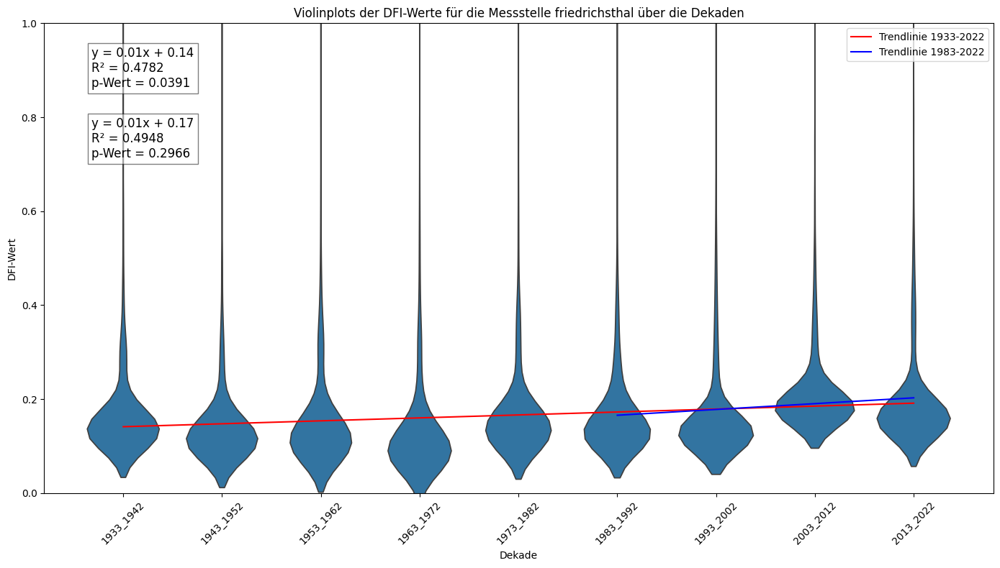

Steigung der Trendlinie 1933-2022: 0.006264114252667907
R² der Trendlinie 1933-2022: 0.47815951554028097
p-Wert der Trendlinie 1933-2022: 0.03908421820469089
Steigung der Trendlinie 1983-2022: 0.012359221806469567
R² der Trendlinie 1983-2022: 0.49477822487773454
p-Wert der Trendlinie 1983-2022: 0.29659526240027745


: 

In [16]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import linregress

# Laden der Excel-Datei
file_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/dfi_transposed_dekaden_merged.xlsx'

df = pd.read_excel(file_path)

# Beispiel-Messstelle für die Analyse
messstelle = 'friedrichsthal'

# Filtern der Daten für die Messstelle
df_filtered = df[df['messstelle'] == messstelle]

# Konvertieren der DFI-Werte in numerische Werte
df_filtered.iloc[:, 3:] = df_filtered.iloc[:, 3:].apply(pd.to_numeric, errors='coerce')

# Daten für Violinplots vorbereiten
df_melted = df_filtered.melt(id_vars=['dekade', 'messstelle', 'n'], var_name='Tag', value_name='DFI-Wert')

# Berechnen der mittleren DFI-Werte pro Dekade
mean_dfi_by_dekade = df_melted.groupby('dekade')['DFI-Wert'].mean().reset_index()

# Überprüfen auf NaN-Werte und diese entfernen
mean_dfi_by_dekade = mean_dfi_by_dekade.dropna()

# Konvertieren in numpy-Arrays und sicherstellen, dass sie keine NaN-Werte enthalten
dekade_nums = np.arange(len(mean_dfi_by_dekade))
mean_dfi_values = mean_dfi_by_dekade['DFI-Wert'].values.astype(np.float64)

# Berechnen der linearen Regression für den gesamten Zeitraum
slope, intercept, r_value, p_value, std_err = linregress(dekade_nums, mean_dfi_values)

# Berechnen der linearen Regression für den Zeitraum 1983-2022
subset = mean_dfi_by_dekade[mean_dfi_by_dekade['dekade'].isin(['1983_1992', '1993_2002', '2003_2012', '2013_2022'])]
subset_dekade_nums = np.arange(len(subset))
subset_mean_dfi_values = subset['DFI-Wert'].values.astype(np.float64)
subset_slope, subset_intercept, subset_r_value, subset_p_value, subset_std_err = linregress(subset_dekade_nums, subset_mean_dfi_values)

# Plotten der Violinplots
plt.figure(figsize=(14, 8))
sns.violinplot(x='dekade', y='DFI-Wert', data=df_melted, inner=None)
plt.title(f'Violinplots der DFI-Werte für die Messstelle {messstelle} über die Dekaden')
plt.xlabel('Dekade')
plt.ylabel('DFI-Wert')
plt.ylim(0, 1)  # Y-Achse auf den Bereich 0 bis 1 beschränken
plt.xticks(rotation=45)

# Plot der Regressionslinien
plt.plot(mean_dfi_by_dekade['dekade'], intercept + slope * dekade_nums, 'r', label='Trendlinie 1933-2022')
plt.plot(subset['dekade'], subset_intercept + subset_slope * subset_dekade_nums, 'b', label='Trendlinie 1983-2022')

# Hinzufügen der Regressionsformeln, R² und p-Werte zum Plot
r_squared = r_value**2
subset_r_squared = subset_r_value**2

formula_text = f'y = {slope:.2f}x + {intercept:.2f}\nR² = {r_squared:.4f}\np-Wert = {p_value:.4f}'
subset_formula_text = f'y = {subset_slope:.2f}x + {subset_intercept:.2f}\nR² = {subset_r_squared:.4f}\np-Wert = {subset_p_value:.4f}'

plt.text(0.05, 0.95, formula_text, transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))
plt.text(0.05, 0.80, subset_formula_text, transform=plt.gca().transAxes, fontsize=12, verticalalignment='top', bbox=dict(facecolor='white', alpha=0.5))

plt.legend()
plt.tight_layout()
plt.show()

print(f"Steigung der Trendlinie 1933-2022: {slope}")
print(f"R² der Trendlinie 1933-2022: {r_squared}")
print(f"p-Wert der Trendlinie 1933-2022: {p_value}")

print(f"Steigung der Trendlinie 1983-2022: {subset_slope}")
print(f"R² der Trendlinie 1983-2022: {subset_r_squared}")
print(f"p-Wert der Trendlinie 1983-2022: {subset_p_value}")


Gedanken: 

das blöde ist, dass es sich um 40 Jahre handelt... eigentlich ist das nicht "eine kurze Zeit" um zu schauen, ob sich was verändert... wäre sinnvoller statt dekaden, kurzere Zeitabschnitte zu nehmen?
Ich könnte aus den letzten 40 Jahren für die Einzugsgebieten die sich signifikant ändern hochaufgelöst rechnen

### Breakpoints Berechnung

[1] "n"   "dfi"
# A tibble: 6 × 2
      n   dfi
  <dbl> <dbl>
1     0 1    
2     1 0.932
3     2 0.846
4     3 0.771
5     4 0.717
6     5 0.658
  [1] 1.00000000 0.93150621 0.84606294 0.77082576 0.71691057 0.65779535
  [7] 0.63471019 0.59971536 0.59051432 0.58161839 0.57238211 0.56587669
 [13] 0.55019329 0.55019329 0.48962199 0.48962199 0.48962199 0.48739654
 [19] 0.47440016 0.46832247 0.46832247 0.43906399 0.41407875 0.41407875
 [25] 0.41407875 0.38791358 0.38791358 0.38791358 0.38791358 0.31344043
 [31] 0.26088602 0.26088602 0.26088602 0.26088602 0.26088602 0.26088602
 [37] 0.26088602 0.26088602 0.26088602 0.23936896 0.19385143 0.19385143
 [43] 0.19385143 0.18460974 0.15805267 0.15805267 0.15805267 0.15805267
 [49] 0.14479497 0.13931499 0.13931499 0.13931499 0.13931499 0.13863050
 [55] 0.13863050 0.13827364 0.13827364 0.12041251 0.12041251 0.12041251
 [61] 0.11145682 0.10302023 0.10302023 0.10302023 0.10302023 0.10302023
 [67] 0.10247684 0.09649606 0.09649606 0.09649606 0.09649606 0

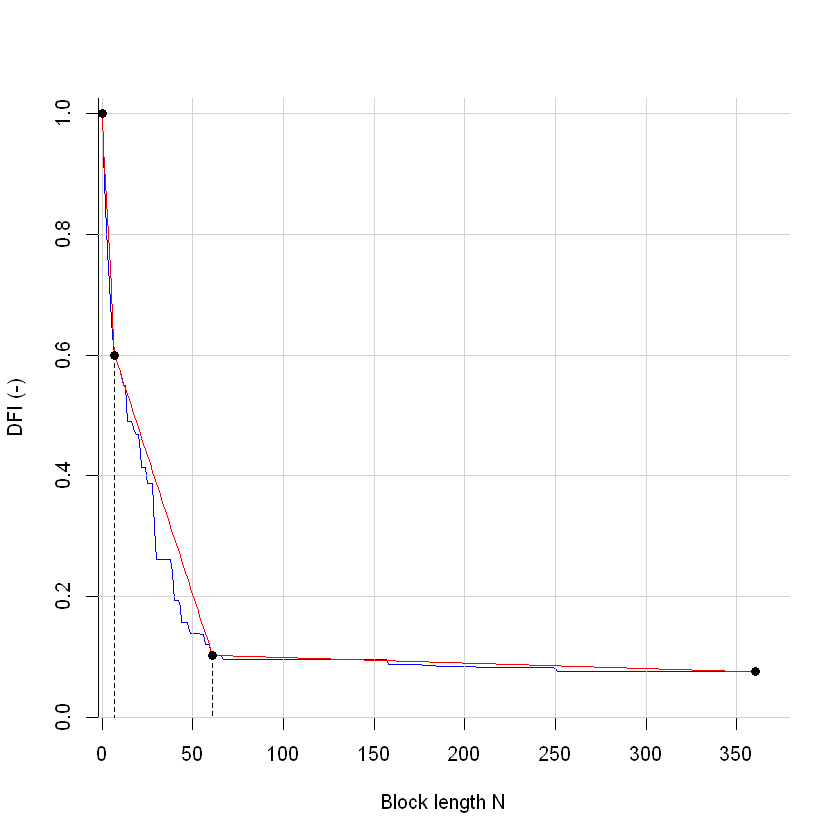

In [12]:
# Laden der notwendigen Pakete
library(readxl)
library(delayedflow)
library(openxlsx)

# Arbeitsverzeichnis setzen
setwd("C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j")

# Funktion zur Berechnung der Breakpoints
find_bps_function <- function(dfi) {
  nmax_value <- as.integer(length(dfi)) # nmax als Ganzzahl setzen
  bps <- find_bps(dfi, n_bp = 2, bp_mingap = 5, bp_min = 0, bp_max = nmax_value - 1, nmax = nmax_value, of_weights = c(0.5, 0.5), desc = TRUE, print = TRUE, plotting = TRUE, experimental = FALSE)
  return(bps$breakpoints)
}

# Datei einlesen
datei <- "dfi_abentheuer_2013_2022.xlsx"
df <- read_excel(datei)

# Überprüfen der Spaltennamen
print(colnames(df))

# Überprüfen der ersten Zeilen der Daten
print(head(df))

# DFI-Spalte extrahieren
dfi_values <- df$dfi

# Überprüfen der DFI-Werte
print(dfi_values)

# Berechnung der Breakpoints
breakpoints <- find_bps_function(dfi_values)

# Ausgabe der Breakpoints
print(breakpoints)


In [2]:
# Laden der notwendigen Pakete
library(readxl)
library(delayedflow)
library(openxlsx)
library(dplyr)

# Setzen des Arbeitsverzeichnisses
setwd("C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j_ohne_NA")

# Verzeichnis der DFI-Dateien
dfi_files <- list.files(pattern = "dfi_.*\\.xlsx")

# Ergebnisliste initialisieren
results_list <- list()

# Funktion zur Berechnung der Breakpoints und Speicherung der Ergebnisse
process_file <- function(file) {
  # Datei einlesen
  dfi_data <- read_excel(file)
  
  # Sicherstellen, dass die DFI-Spalte vorhanden ist
  if (!"dfi" %in% colnames(dfi_data)) {
    cat("Die Spalte 'dfi' ist in der Datei", file, "nicht vorhanden.\n")
    return(NULL)
  }
  
  # Berechnung der Breakpoints
  bps <- find_bps(dfi_data$dfi, n_bp = 2)
  
  # Extrahieren der Breakpoints und relativen Beiträge
  bp1 <- bps$bps_position["bp_1"]
  bp2 <- bps$bps_position["bp_2"]
  contr1 <- bps$rel_contr["contr_1"]
  contr2 <- bps$rel_contr["contr_2"]
  contr3 <- bps$rel_contr["contr_3"]
  bias <- bps$bias
  
  # Ergebnis speichern
  result <- data.frame(
    file = file,
    bp1 = bp1,
    bp2 = bp2,
    contr1 = contr1,
    contr2 = contr2,
    contr3 = contr3,
    bias = bias
  )
  
  return(result)
}

# Alle Dateien im Verzeichnis verarbeiten
for (file in dfi_files) {
  cat("Verarbeite Datei:", file, "\n")
  result <- process_file(file)
  if (!is.null(result)) {
    results_list <- append(results_list, list(result))
  }
}

# Ergebnisse zusammenführen und speichern
results_df <- bind_rows(results_list)
write.xlsx(results_df, "breakpoints_results.xlsx")
cat("Ergebnisse wurden in 'breakpoints_results.xlsx' gespeichert.\n")


Verarbeite Datei: dfi_abentheuer_1963_1972.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_abentheuer_1973_1982.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_abentheuer_1983_1992.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_abentheuer_1993_2002.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_abentheuer_2003_2012.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_abentheuer_2013_2022.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_albisheim_1963_1972.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_albisheim_1973_1982.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_albisheim_1983_1992.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_albisheim_1993_2002.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_albisheim_2003_2012.xlsx 
Calculating breakpoints...Done. 

Verarbeite Datei: dfi_albisheim_2013_2022.xlsx 
Calculating breakpoints...Done. 

Verarbeite

# 4.6 Climate Change: Examining Temporal Changes in Runoff Patterns
Trends of the Mean Delayed-Flow Index (DFI) across different decades, with subplots for the overall trend (a), Section 1 (b), Section 2 (c), and Section 3 (d). Boxplots represent the distribution of DFI values, and the black lines show the linear regression trends.

## Analysis of Delayed-Flow Index Trends Over Time

### Main Catchments

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

# Setze Times New Roman als Standard-Schriftart für Matplotlib und erhöhe die DPI
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'text.usetex': False,  # Setze auf False, um sicherzustellen, dass LaTeX nicht verwendet wird
    'axes.titlesize': 16,  # Schriftgröße für den Titel der Achsen
    'axes.labelsize': 14,  # Schriftgröße für die Labels der Achsen
    'xtick.labelsize': 14,  # Schriftgröße für die X-Achsen-Ticks
    'ytick.labelsize': 14,  # Schriftgröße für die Y-Achsen-Ticks
    'legend.fontsize': 10,  # Schriftgröße für die Legende
    'figure.figsize': (12, 8),  # Größe der Figuren
    'figure.dpi': 800,  # Setze DPI auf 1000
    #'axes.labelweight': 'bold',  # Gewicht der Achsen-Labels
    #'axes.titleweight': 'bold',  # Gewicht der Achsen-Titel
    #'lines.linewidth': 2,  # Linienbreite für Plots
    #'grid.linestyle': '--',  # Stil für das Gitter
    #'grid.linewidth': 0.5,  # Breite der Gitterlinien
    #'grid.color': 'black',  # Farbe des Gitters
})

# Excel-Datei laden
file_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/long_form_ges_ezg.xlsx'
df = pd.read_excel(file_path)

# Funktion zur Durchführung der linearen Regression und Erhalt der Trendlinie und statistischer Werte
def get_trendline_stats(x, y):
    X = sm.add_constant(x)  # Add a constant term for the intercept
    model = sm.OLS(y, X).fit()  # Fit the model
    trendline = model.predict(X)  # Predict trendline
    slope = model.params[1]
    p_value = model.pvalues[1]
    r_squared = model.rsquared
    return trendline, slope, p_value, r_squared

# Reihenfolge der Dekaden sicherstellen und Dekaden ohne Unterstriche darstellen
dekade_order = ['1963-1972', '1973-1982', '1983-1992', '1993-2002', '2003-2012', '2013-2022']
df['dekade'] = df['dekade'].str.replace('_', '-')
df['dekade'] = pd.Categorical(df['dekade'], categories=dekade_order, ordered=True)

# Dekaden in numerisches Format konvertieren
df['dekade_num'] = df['dekade'].cat.codes

# Boxplots und Regressionslinien berechnen
sections = ['section1', 'section2', 'section3', 'dfi60']
labels = ['Section 1', 'Section 2', 'Section 3', 'DFI 60']

# Berechnung der Regressionslinien und statistischen Werte für jede Sektion
statistics = []

for section in sections:
    section_data = df[df['section'] == section].groupby('dekade')['dfi'].mean().reset_index()
    section_data['dekade_num'] = section_data['dekade'].cat.codes
    trendline, slope, p_value, r_squared = get_trendline_stats(section_data['dekade_num'], section_data['dfi'])
    statistics.append({
        'Category': section,
        'Slope': slope,
        'P-value': p_value,
        'R-squared': r_squared
    })

# Berechnung der Regressionslinie und statistischen Werte für den Gesamtverlauf
average_dfi_total = df.groupby('dekade')['dfi'].mean().reset_index()
average_dfi_total['dekade_num'] = average_dfi_total['dekade'].cat.codes
trendline_total, slope_total, p_value_total, r_squared_total = get_trendline_stats(average_dfi_total['dekade_num'], average_dfi_total['dfi'])
statistics.append({
    'Category': 'Overall',
    'Slope': slope_total,
    'P-value': p_value_total,
    'R-squared': r_squared_total
})

# Konvertiere Statistiken in DataFrame zur Anzeige
statistics_df = pd.DataFrame(statistics)

# Plot erstellen
fig, axs = plt.subplots(2, 2, figsize=(18, 12))

# Buchstaben für die Plots
plot_labels = ['(a)', '(b)', '(c)', '(d)']

# Positioniere die Buchstaben in der Mitte der Plots
positions = [(0.05, 0.95), (0.05, 0.95), (0.05, 0.95), (0.05, 0.95)]

# Boxplots und Regressionslinien für die Sektionen
for i, section in enumerate(sections):
    sns.boxplot(x='dekade', y='dfi', data=df[df['section'] == section], order=dekade_order, color='white', boxprops=dict(edgecolor='black'), ax=axs[i//2, i%2])
    section_data = df[df['section'] == section].groupby('dekade')['dfi'].mean().reset_index()
    section_data['dekade_num'] = section_data['dekade'].cat.codes
    trendline, slope, p_value, r_squared = get_trendline_stats(section_data['dekade_num'], section_data['dfi'])
    axs[i//2, i%2].plot(section_data['dekade'], trendline, linestyle='-', color='black', linewidth=2)
    axs[i//2, i%2].set_xlabel('', fontsize=14)
    axs[i//2, i%2].set_ylabel('Mean Delayed-Flow Index', fontsize=18)
    axs[i//2, i%2].grid(False)
    axs[i//2, i%2].set_ylim(0, 1)
    axs[i//2, i%2].tick_params(axis='x')
    axs[i//2, i%2].text(positions[i][0], positions[i][1], plot_labels[i], transform=axs[i//2, i%2].transAxes, fontsize=16, fontweight='bold', va='center', ha='center')

plt.tight_layout()
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_1_klima_sections_decades_ges_ezg.png', dpi=800)
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_1_klima_sections_decades_ges_ezg.svg', format='svg')  # Speichere die Abbildung als svg
plt.show()

# Gesamtverlauf als einzelnen Plot speichern
fig, ax = plt.subplots(figsize=(12, 8))
sns.boxplot(x='dekade', y='dfi', data=df, order=dekade_order, color='white', boxprops=dict(edgecolor='black'), ax=ax)
ax.plot(average_dfi_total['dekade'], trendline_total, linestyle='-', color='black', linewidth=2)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('Mean Delayed-Flow Index', fontsize=18)
ax.grid(False)
ax.set_ylim(0, 1)
ax.tick_params(axis='x')
plt.tight_layout()
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_1_klima_overall_decades_ges_ezg.png', dpi=800)
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_1_klima_overall_decades_ges_ezg.svg', format='svg')  # Speichere die Abbildung als svg
plt.show()

# Statistiken anzeigen
print(statistics_df)


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2330955182.py:57: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  section_data = df[df['section'] == section].groupby('dekade')['dfi'].mean().reset_index()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2330955182.py:36: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  slope = model.params[1]
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2330955182.py:37: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position

   Category     Slope   P-value  R-squared
0  section1  0.011239  0.045581   0.672744
1  section2  0.004841  0.296493   0.264574
2  section3 -0.000593  0.878311   0.006611
3     dfi60 -0.006378  0.220714   0.344470
4   Overall -0.000864  0.804908   0.017111


### Sub catchments

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

# Setze Times New Roman als Standard-Schriftart für Matplotlib und erhöhe die DPI
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'text.usetex': False,  # Setze auf False, um sicherzustellen, dass LaTeX nicht verwendet wird
    'axes.titlesize': 16,  # Schriftgröße für den Titel der Achsen
    'axes.labelsize': 14,  # Schriftgröße für die Labels der Achsen
    'xtick.labelsize': 14,  # Schriftgröße für die X-Achsen-Ticks
    'ytick.labelsize': 14,  # Schriftgröße für die Y-Achsen-Ticks
    'legend.fontsize': 10,  # Schriftgröße für die Legende
    'figure.figsize': (12, 8),  # Größe der Figuren
    'figure.dpi': 800,  # Setze DPI auf 1000
    #'axes.labelweight': 'bold',  # Gewicht der Achsen-Labels
    #'axes.titleweight': 'bold',  # Gewicht der Achsen-Titel
    #'lines.linewidth': 2,  # Linienbreite für Plots
    #'grid.linestyle': '--',  # Stil für das Gitter
    #'grid.linewidth': 0.5,  # Breite der Gitterlinien
    #'grid.color': 'black',  # Farbe des Gitters
})

# Excel-Datei laden
file_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/long_form_teil_ezg.xlsx'
df = pd.read_excel(file_path)

# Funktion zur Durchführung der linearen Regression und Erhalt der Trendlinie und statistischer Werte
def get_trendline_stats(x, y):
    X = sm.add_constant(x)  # Add a constant term for the intercept
    model = sm.OLS(y, X).fit()  # Fit the model
    trendline = model.predict(X)  # Predict trendline
    slope = model.params[1]
    p_value = model.pvalues[1]
    r_squared = model.rsquared
    return trendline, slope, p_value, r_squared

# Reihenfolge der Dekaden sicherstellen und Dekaden ohne Unterstriche darstellen
dekade_order = ['1973-1982', '1983-1992', '1993-2002', '2003-2012', '2013-2022']
df['dekade'] = df['dekade'].str.replace('_', '-')
df['dekade'] = pd.Categorical(df['dekade'], categories=dekade_order, ordered=True)

# Dekaden in numerisches Format konvertieren
df['dekade_num'] = df['dekade'].cat.codes

# Boxplots und Regressionslinien berechnen
sections = ['section1', 'section2', 'section3', 'dfi60']
labels = ['Section 1', 'Section 2', 'Section 3', 'DFI 60']

# Berechnung der Regressionslinien und statistischen Werte für jede Sektion
statistics = []

for section in sections:
    section_data = df[df['section'] == section].groupby('dekade')['dfi'].mean().reset_index()
    section_data['dekade_num'] = section_data['dekade'].cat.codes
    trendline, slope, p_value, r_squared = get_trendline_stats(section_data['dekade_num'], section_data['dfi'])
    statistics.append({
        'Category': section,
        'Slope': slope,
        'P-value': p_value,
        'R-squared': r_squared
    })

# Berechnung der Regressionslinie und statistischen Werte für den Gesamtverlauf
average_dfi_total = df.groupby('dekade')['dfi'].mean().reset_index()
average_dfi_total['dekade_num'] = average_dfi_total['dekade'].cat.codes
trendline_total, slope_total, p_value_total, r_squared_total = get_trendline_stats(average_dfi_total['dekade_num'], average_dfi_total['dfi'])
statistics.append({
    'Category': 'Overall',
    'Slope': slope_total,
    'P-value': p_value_total,
    'R-squared': r_squared_total
})

# Konvertiere Statistiken in DataFrame zur Anzeige
statistics_df = pd.DataFrame(statistics)

# Plot erstellen
fig, axs = plt.subplots(2, 2, figsize=(18, 12))

# Buchstaben für die Plots
plot_labels = ['(a)', '(b)', '(c)', '(d)']

# Positioniere die Buchstaben in der Mitte der Plots
positions = [(0.05, 0.95), (0.05, 0.95), (0.05, 0.95), (0.05, 0.95)]

# Boxplots und Regressionslinien für die Sektionen
for i, section in enumerate(sections):
    sns.boxplot(x='dekade', y='dfi', data=df[df['section'] == section], order=dekade_order, color='white', boxprops=dict(edgecolor='black'), ax=axs[i//2, i%2])
    section_data = df[df['section'] == section].groupby('dekade')['dfi'].mean().reset_index()
    section_data['dekade_num'] = section_data['dekade'].cat.codes
    trendline, slope, p_value, r_squared = get_trendline_stats(section_data['dekade_num'], section_data['dfi'])
    axs[i//2, i%2].plot(section_data['dekade'], trendline, linestyle='-', color='black', linewidth=2)
    axs[i//2, i%2].set_xlabel('', fontsize=14)
    axs[i//2, i%2].set_ylabel('Mean Delayed-Flow Index', fontsize=18)
    axs[i//2, i%2].grid(False)
    axs[i//2, i%2].set_ylim(0, 1)
    axs[i//2, i%2].tick_params(axis='x')
    axs[i//2, i%2].text(positions[i][0], positions[i][1], plot_labels[i], transform=axs[i//2, i%2].transAxes, fontsize=16, fontweight='bold', va='center', ha='center')

plt.tight_layout()
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_2_klima_sections_decades_teil_ezg.png', dpi=800)
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_2_klima_sections_decades_teil_ezg.svg', format='svg')  # Speichere die Abbildung als svg
plt.show()

# Gesamtverlauf als einzelnen Plot speichern
fig, ax = plt.subplots(figsize=(12, 8))
sns.boxplot(x='dekade', y='dfi', data=df, order=dekade_order, color='white', boxprops=dict(edgecolor='black'), ax=ax)
ax.plot(average_dfi_total['dekade'], trendline_total, linestyle='-', color='black', linewidth=2)
ax.set_xlabel('', fontsize=14)
ax.set_ylabel('Mean Delayed-Flow Index', fontsize=18)
ax.grid(False)
ax.set_ylim(0, 1)
ax.tick_params(axis='x')
plt.tight_layout()
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_2_klima_overall_decades_teil_ezg.png', dpi=800)
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_2_klima_overall_decades_teil_ezg.svg', format='svg')  # Speichere die Abbildung als svg
plt.show()

# Statistiken anzeigen
print(statistics_df)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\460158436.py:57: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  section_data = df[df['section'] == section].groupby('dekade')['dfi'].mean().reset_index()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\460158436.py:36: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  slope = model.params[1]
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\460158436.py:37: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, u

   Category     Slope   P-value  R-squared
0  section1  0.002307  0.628194   0.087862
1  section2 -0.010285  0.030710   0.832479
2  section3 -0.009517  0.083680   0.684902
3     dfi60 -0.017899  0.050326   0.770540
4   Overall -0.011940  0.036201   0.813867


## Analysis of Delayed-Flow Index Trends Over Time Within Clusters

### 4.6 Main Catchments

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from matplotlib import font_manager

if 'Times New Roman' not in [f.name for f in font_manager.fontManager.ttflist]:
    print("Times New Roman is not installed. Please install it to use it in plots.")

# Standard-Schriftart für Matplotlib und DPI
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'text.usetex': False,  # Setze auf False, um sicherzustellen, dass LaTeX nicht verwendet wird
    'axes.titlesize': 16,  # Schriftgröße für den Titel der Achsen
    'axes.labelsize': 14,  # Schriftgröße für die Labels der Achsen
    'xtick.labelsize': 11,  # Schriftgröße für die X-Achsen-Ticks (verkleinert)
    'ytick.labelsize': 14,  # Schriftgröße für die Y-Achsen-Ticks
    'legend.fontsize': 10,  # Schriftgröße für die Legende
    'figure.figsize': (24, 30),  # Größe der Figuren
    'figure.dpi': 800,  # Setze DPI auf 1000
})

# Excel-Datei laden
file_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/long_form_ges_ezg.xlsx'
df = pd.read_excel(file_path)

# Funktion zur Durchführung der linearen Regression + Trendlinie und Stat. Werte
def get_trendline_stats(x, y):
    X = sm.add_constant(x)  # Add a constant term for the intercept
    model = sm.OLS(y, X).fit()  # Fit the model
    trendline = model.predict(X)  # Predict trendline
    slope = model.params[1]
    p_value = model.pvalues[1]
    r_squared = model.rsquared
    return trendline, slope, p_value, r_squared

# Reihenfolge der Dekaden sicherstellen und Dekaden ohne Unterstriche darstellen
dekade_order = ['1963-1972', '1973-1982', '1983-1992', '1993-2002', '2003-2012', '2013-2022']
df['dekade'] = df['dekade'].str.replace('_', '-')
df['dekade'] = pd.Categorical(df['dekade'], categories=dekade_order, ordered=True)

# Dekaden in numerisches Format konvertieren
df['dekade_num'] = df['dekade'].cat.codes

# Plot erstellen
fig, axs = plt.subplots(5, 4, figsize=(24, 30))

# Cluster und Sektionen definieren
clusters = [1, 2, 3, 4]
sections = ['overall', 'section1', 'section2', 'section3', 'dfi60']
section_labels = ['Overall', 'Short-delay Class', 'Intermediate-delay Class', 'Long-delay Class', 'Baseline-delay Class']

statistics = []

# Boxplots und Regressionslinien für die Sektionen innerhalb der Cluster
for j, cluster in enumerate(clusters):
    for i, section in enumerate(sections):
        if section == 'overall':
            section_data = df[df['cluster'] == cluster].groupby('dekade')['dfi'].mean().reset_index()
            plot_data = df[df['cluster'] == cluster]
        else:
            section_data = df[(df['cluster'] == cluster) & (df['section'] == section)].groupby('dekade')['dfi'].mean().reset_index()
            plot_data = df[(df['cluster'] == cluster) & (df['section'] == section)]
            
        section_data['dekade_num'] = section_data['dekade'].cat.codes
        
        if not section_data.empty:
            trendline, slope, p_value, r_squared = get_trendline_stats(section_data['dekade_num'], section_data['dfi'])
            statistics.append({
                'Cluster': cluster,
                'Section': section_labels[i],
                'Slope': slope,
                'P-value': p_value,
                'R-squared': r_squared
            })
            
            sns.boxplot(x='dekade', y='dfi', data=plot_data, order=dekade_order, color='white', boxprops=dict(edgecolor='black'), ax=axs[i, j])
            axs[i, j].plot(section_data['dekade'], trendline, linestyle='-', color='black', linewidth=2)
            axs[i, j].set_xlabel('', fontsize=14, fontname='Times New Roman')
            axs[i, j].set_ylabel('Mean Delayed-Flow Index', fontsize=14, fontname='Times New Roman')
            axs[i, j].grid(False)
            axs[i, j].set_ylim(0, 1)
            axs[i, j].tick_params(axis='x', labelsize=11)  # Schriftgröße der X-Achsen-Ticks verkleinern und rotieren
            axs[i, j].tick_params(axis='y', labelsize=14)
            axs[i, j].set_title(f'Cluster {cluster} - {section_labels[i]}', fontsize=16, fontname='Times New Roman')

plt.tight_layout()
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_3_klima_clusters_sections_decades_ges_ezg.png', dpi=800)
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_3_klima_clusters_sections_decades_ges_ezg.svg', format='svg')
plt.show()

# Statistiken anzeigen
statistics_df = pd.DataFrame(statistics)
print(statistics_df)


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2723814477.py:60: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  section_data = df[df['cluster'] == cluster].groupby('dekade')['dfi'].mean().reset_index()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2723814477.py:33: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  slope = model.params[1]
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2723814477.py:34: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position

    Cluster                   Section     Slope   P-value  R-squared
0         1                   Overall -0.002154  0.272997   0.287294
1         1         Short-delay Class  0.013864  0.046375   0.670104
2         1  Intermediate-delay Class  0.003619  0.487673   0.127218
3         1          Long-delay Class -0.001879  0.432846   0.159463
4         1      Baseline-delay Class -0.006576  0.039083   0.695425
5         2                   Overall  0.000523  0.856679   0.009185
6         2         Short-delay Class  0.013369  0.016418   0.798290
7         2  Intermediate-delay Class  0.007213  0.055707   0.640871
8         2          Long-delay Class -0.000107  0.973558   0.000311
9         2      Baseline-delay Class -0.005075  0.248186   0.313189
10        3                   Overall  0.006301  0.401235   0.180382
11        3         Short-delay Class  0.020728  0.037962   0.699549
12        3  Intermediate-delay Class  0.017858  0.137718   0.461555
13        3          Long-delay Cl

### 4.6 Subcatchments

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from matplotlib import font_manager

if 'Times New Roman' not in [f.name for f in font_manager.fontManager.ttflist]:
    print("Times New Roman is not installed. Please install it to use it in plots.")

# Standard-Schriftart für Matplotlib und DPI
plt.rcParams.update({
    'font.family': 'serif',
    'font.serif': ['Times New Roman'],
    'text.usetex': False,  # Setze auf False, um sicherzustellen, dass LaTeX nicht verwendet wird
    'axes.titlesize': 16,  # Schriftgröße für den Titel der Achsen
    'axes.labelsize': 14,  # Schriftgröße für die Labels der Achsen
    'xtick.labelsize': 11,  # Schriftgröße für die X-Achsen-Ticks (verkleinert)
    'ytick.labelsize': 14,  # Schriftgröße für die Y-Achsen-Ticks
    'legend.fontsize': 10,  # Schriftgröße für die Legende
    'figure.figsize': (24, 30),  # Größe der Figuren
    'figure.dpi': 800,  # Setze DPI auf 1000
})

# Excel-Datei laden
file_path = 'C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/long_form_teil_ezg.xlsx'
df = pd.read_excel(file_path)

# Funktion zur Durchführung der linearen Regression + Trendlinie und Stat. Werte
def get_trendline_stats(x, y):
    X = sm.add_constant(x)  # Add a constant term for the intercept
    model = sm.OLS(y, X).fit()  # Fit the model
    trendline = model.predict(X)  # Predict trendline
    slope = model.params[1]
    p_value = model.pvalues[1]
    r_squared = model.rsquared
    return trendline, slope, p_value, r_squared

# Reihenfolge der Dekaden sicherstellen und Dekaden ohne Unterstriche darstellen
dekade_order = ['1973-1982', '1983-1992', '1993-2002', '2003-2012', '2013-2022']
df['dekade'] = df['dekade'].str.replace('_', '-')
df['dekade'] = pd.Categorical(df['dekade'], categories=dekade_order, ordered=True)

# Dekaden in numerisches Format konvertieren
df['dekade_num'] = df['dekade'].cat.codes

# Plot erstellen
fig, axs = plt.subplots(5, 4, figsize=(24, 30))

# Cluster und Sektionen definieren
clusters = [1, 2, 3, 4]
sections = ['overall', 'section1', 'section2', 'section3', 'dfi60']
section_labels = ['Overall', 'Short-delay Class', 'Intermediate-delay Class', 'Long-delay Class', 'Baseline-delay Class']

statistics = []

# Boxplots und Regressionslinien für die Sektionen innerhalb der Cluster
for j, cluster in enumerate(clusters):
    for i, section in enumerate(sections):
        if section == 'overall':
            section_data = df[df['cluster'] == cluster].groupby('dekade')['dfi'].mean().reset_index()
            plot_data = df[df['cluster'] == cluster]
        else:
            section_data = df[(df['cluster'] == cluster) & (df['section'] == section)].groupby('dekade')['dfi'].mean().reset_index()
            plot_data = df[(df['cluster'] == cluster) & (df['section'] == section)]
            
        section_data['dekade_num'] = section_data['dekade'].cat.codes
        
        if not section_data.empty:
            trendline, slope, p_value, r_squared = get_trendline_stats(section_data['dekade_num'], section_data['dfi'])
            statistics.append({
                'Cluster': cluster,
                'Section': section_labels[i],
                'Slope': slope,
                'P-value': p_value,
                'R-squared': r_squared
            })
            
            sns.boxplot(x='dekade', y='dfi', data=plot_data, order=dekade_order, color='white', boxprops=dict(edgecolor='black'), ax=axs[i, j])
            axs[i, j].plot(section_data['dekade'], trendline, linestyle='-', color='black', linewidth=2)
            axs[i, j].set_xlabel('', fontsize=14, fontname='Times New Roman')
            axs[i, j].set_ylabel('Mean Delayed-Flow Index', fontsize=14, fontname='Times New Roman')
            axs[i, j].grid(False)
            axs[i, j].set_ylim(0, 1)
            axs[i, j].tick_params(axis='x', labelsize=11)  # Schriftgröße der X-Achsen-Ticks verkleinern und rotieren
            axs[i, j].tick_params(axis='y', labelsize=14)
            axs[i, j].set_title(f'Cluster {cluster} - {section_labels[i]}', fontsize=16, fontname='Times New Roman')

plt.tight_layout()
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_4_klima_clusters_sections_decades_teil_ezg.png', dpi=800)
plt.savefig('C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/3_arbeitsordner/Abbildungen/6.4_4_klima_clusters_sections_decades_teil_ezg.svg', format='svg')
plt.show()

# Statistiken anzeigen
statistics_df = pd.DataFrame(statistics)
print(statistics_df)

C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\1913085407.py:60: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  section_data = df[df['cluster'] == cluster].groupby('dekade')['dfi'].mean().reset_index()
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\1913085407.py:33: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  slope = model.params[1]
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\1913085407.py:34: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position

    Cluster                   Section     Slope   P-value  R-squared
0         1                   Overall -0.001551  0.603301   0.100462
1         1         Short-delay Class  0.006885  0.378761   0.261268
2         1  Intermediate-delay Class  0.004057  0.527161   0.144993
3         1          Long-delay Class -0.000946  0.802681   0.024213
4         1      Baseline-delay Class -0.006037  0.281933   0.363339
5         2                   Overall -0.004642  0.242889   0.412112
6         2         Short-delay Class  0.008407  0.098925   0.650944
7         2  Intermediate-delay Class  0.003633  0.309284   0.331984
8         2          Long-delay Class -0.003013  0.481862   0.176069
9         2      Baseline-delay Class -0.011332  0.150641   0.551322
10        3                   Overall -0.004655  0.643921   0.080377
11        3         Short-delay Class  0.000791  0.942296   0.002055
12        3  Intermediate-delay Class -0.005906  0.609409   0.097284
13        3          Long-delay Cl

# 4.7 Analysis of Delayed-Flow Index Trends Over Time Within Clusters for Winter and Summer

DFI Berechnung für neue Daten! 
mit n=180


NOTIZEN
Daten trennen in 

--> Hydrologisches Sommer: Mai-Okt

--> Hydrologisches Winter: Nov-Apr



In C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\1_abfluss
habe 124 exceldateien. Sie sind nach je ein einzugsgebiet bennant und haben den präfix "abfluss_"

ich möchte jede einzelne Datei wie folgt trennen

Hydr_sommer: alle datenreihen von Mai bis Okt in den Ordner: C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\5_saisonalitaet_klimawandel\saisonalitaet\abfluss\hydr_sommer
Hydr_winter: alle datenrehien von Nov bis Apr in den Ordner: C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\5_saisonalitaet_klimawandel\saisonalitaet\abfluss\hydr_winter


--> trend-analyse?


### Aus abflussdaten (10 Jahresabschnitte)- trennen in Winter und Sommer 
Mai-Oktober & Nov-Apr mit n=180


input_verzeichnis <- "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j" 

daten trennen in 

Sommer = Mai-Okt : C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\6_saisonalitaet_klimawandel\saisonalitaet\abfluss\hydr_sommer
Winter= Nov-Apr C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\6_saisonalitaet_klimawandel\saisonalitaet\abfluss\hydr_winter

In [13]:
import os
import pandas as pd
from pathlib import Path

# Verzeichnisse festlegen
input_verzeichnis = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/10j"
output_verzeichnis_sommer = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/saisonalitaet/abfluss/hydr_sommer"
output_verzeichnis_winter = "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/6_saisonalitaet_klimawandel/saisonalitaet/abfluss/hydr_winter"

# Stelle sicher, dass die Ausgabeverzeichnisse existieren
os.makedirs(output_verzeichnis_sommer, exist_ok=True)
os.makedirs(output_verzeichnis_winter, exist_ok=True)

# Alle Excel-Dateien im Eingabeverzeichnis finden
input_files = Path(input_verzeichnis).glob("*.xlsx")

# Durch jede Datei iterieren
for file_path in input_files:
    # Excel-Datei laden
    df = pd.read_excel(file_path)

    # Stelle sicher, dass das Datum als Datetime-Objekt erkannt wird
    df['datum'] = pd.to_datetime(df['datum'], errors='coerce')

    # Filtere die Daten für Sommer (Mai-Oktober)
    df_sommer = df[df['datum'].dt.month.isin([5, 6, 7, 8, 9, 10])]

    # Filtere die Daten für Winter (November-April)
    df_winter = df[df['datum'].dt.month.isin([11, 12, 1, 2, 3, 4])]

    # Dateiname für die Ausgabedateien erstellen
    filename = file_path.stem
    sommer_file_path = os.path.join(output_verzeichnis_sommer, f"{filename}_sommer.xlsx")
    winter_file_path = os.path.join(output_verzeichnis_winter, f"{filename}_winter.xlsx")

    # Gefilterte Daten in neue Excel-Dateien speichern
    df_sommer.to_excel(sommer_file_path, index=False)
    df_winter.to_excel(winter_file_path, index=False)

print("Daten wurden erfolgreich nach Sommer und Winter getrennt und gespeichert.")


C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2691667757.py:23: UserWarning: Parsing dates in %d.%m.%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df['datum'] = pd.to_datetime(df['datum'], errors='coerce')
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2691667757.py:23: UserWarning: Parsing dates in %d.%m.%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df['datum'] = pd.to_datetime(df['datum'], errors='coerce')
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2691667757.py:23: UserWarning: Parsing dates in %d.%m.%Y format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df['datum'] = pd.to_datetime(df['datum'], errors='coerce')
C:\Users\Lenovo\AppData\Local\Temp\ipykernel_9104\2691667757.py:23: UserWarning: Parsing dates in %d.%m.%Y format when dayfirst=Fa

Daten wurden erfolgreich nach Sommer und Winter getrennt und gespeichert.


aus den datensätze mit n=360 dfi berechnen
Input
Sommer = Mai-Okt : C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\6_saisonalitaet_klimawandel\saisonalitaet\abfluss\hydr_sommer
Winter= Nov-Apr C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\6_saisonalitaet_klimawandel\saisonalitaet\abfluss\hydr_winter

Output
C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\2_dfi\dfi_seasonality\dfi_sommer
C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\2_dfi\dfi_seasonality\dfi_winter


Input

C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\2_dfi\dfi_seasonality\dfi_sommer
C:\Users\Lenovo\Documents\Masterarbeit\Masterarbeit\1_daten\2_dfi\dfi_seasonality\dfi_winter

Output

Breakpoints Berechnung

In [ ]:
# Laden der notwendigen Pakete
library(readxl)
library(delayedflow)
library(openxlsx)
library(dplyr)

# Setzen des Arbeitsverzeichnisses
setwd("C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_10j_ohne_NA")

# Verzeichnis der DFI-Dateien
dfi_files <- list.files(pattern = "dfi_.*\\.xlsx")

# Ergebnisliste initialisieren
results_list <- list()

# Funktion zur Berechnung der Breakpoints und Speicherung der Ergebnisse
process_file <- function(file) {
  # Datei einlesen
  dfi_data <- read_excel(file)
  
  # Sicherstellen, dass die DFI-Spalte vorhanden ist
  if (!"dfi" %in% colnames(dfi_data)) {
    cat("Die Spalte 'dfi' ist in der Datei", file, "nicht vorhanden.\n")
    return(NULL)
  }
  
  # Berechnung der Breakpoints
  bps <- find_bps(dfi_data$dfi, n_bp = 2)
  
  # Extrahieren der Breakpoints und relativen Beiträge
  bp1 <- bps$bps_position["bp_1"]
  bp2 <- bps$bps_position["bp_2"]
  contr1 <- bps$rel_contr["contr_1"]
  contr2 <- bps$rel_contr["contr_2"]
  contr3 <- bps$rel_contr["contr_3"]
  bias <- bps$bias
  
  # Ergebnis speichern
  result <- data.frame(
    file = file,
    bp1 = bp1,
    bp2 = bp2,
    contr1 = contr1,
    contr2 = contr2,
    contr3 = contr3,
    bias = bias
  )
  
  return(result)
}

# Alle Dateien im Verzeichnis verarbeiten
for (file in dfi_files) {
  cat("Verarbeite Datei:", file, "\n")
  result <- process_file(file)
  if (!is.null(result)) {
    results_list <- append(results_list, list(result))
  }
}

# Ergebnisse zusammenführen und speichern
results_df <- bind_rows(results_list)
write.xlsx(results_df, "C:/Users/Lenovo/Documents/Masterarbeit/Masterarbeit/1_daten/2_dfi/dfi_seasonality/breakpoints_results_seasons.xlsx")
cat("Ergebnisse wurden in 'breakpoints_results_seasons.xlsx' gespeichert.\n")